## IMPORTING NECESSARY LIBRARIES

In [1]:
# Install dependencies (on Kaggle, many packages like torch, torchvision, numpy are pre-installed)

!pip install torchdiffeq==0.2.3 pytorch-fid opencv-python-headless

 



import os


# Verify GPU and environment
!nvidia-smi
import torch
print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")
print(f"GPU device: {torch.cuda.get_device_name(0) if torch.cuda.is_available() else 'None'}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00:00:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.7 MB/s eta 0:00:00:00:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 25.4 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.1 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 36.8 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.10.19
    Uninstalling nvidia-curand-cu12-10.3

In [2]:
ucf101_dir = '/kaggle/input/ucf101-dataset/UCF101/UCF-101'
!ls {ucf101_dir}

ApplyEyeMakeup	   Drumming	       MilitaryParade	   Shotput
ApplyLipstick	   Fencing	       Mixing		   SkateBoarding
Archery		   FieldHockeyPenalty  MoppingFloor	   Skiing
BabyCrawling	   FloorGymnastics     Nunchucks	   Skijet
BalanceBeam	   FrisbeeCatch        ParallelBars	   SkyDiving
BandMarching	   FrontCrawl	       PizzaTossing	   SoccerJuggling
BaseballPitch	   GolfSwing	       PlayingCello	   SoccerPenalty
Basketball	   Haircut	       PlayingDaf	   StillRings
BasketballDunk	   Hammering	       PlayingDhol	   SumoWrestling
BenchPress	   HammerThrow	       PlayingFlute	   Surfing
Biking		   HandstandPushups    PlayingGuitar	   Swing
Billiards	   HandstandWalking    PlayingPiano	   TableTennisShot
BlowDryHair	   HeadMassage	       PlayingSitar	   TaiChi
BlowingCandles	   HighJump	       PlayingTabla	   TennisSwing
BodyWeightSquats   HorseRace	       PlayingViolin	   ThrowDiscus
Bowling		   HorseRiding	       PoleVault	   TrampolineJumping
BoxingPunchingBag  HulaHoop	       PommelH

## IMFORMATION ABOUT THE DATASET

In [3]:
import cv2
from pathlib import Path
import os

# Define UCF101 path
raw_dir = '/kaggle/input/ucf101-dataset/UCF101/UCF-101'

# Count total videos and videos per class
total_videos = 0
class_video_counts = {}
for class_dir in Path(raw_dir).iterdir():
    if not class_dir.is_dir():
        continue
    class_name = class_dir.name
    video_files = list(class_dir.glob('*.avi'))
    class_video_counts[class_name] = len(video_files)
    total_videos += len(video_files)

# Analyze sample video properties (resolution, frame count) for one video per class
sample_properties = {}
for class_name in class_video_counts:
    video_path = next(Path(raw_dir).joinpath(class_name).glob('*.avi'), None)
    if video_path:
        cap = cv2.VideoCapture(str(video_path))
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        fps = cap.get(cv2.CAP_PROP_FPS)
        cap.release()
        sample_properties[class_name] = {
            'resolution': (width, height),
            'frame_count': frame_count,
            'fps': fps
        }

# Print summary
print(f"Total videos: {total_videos}")
print(f"Number of classes: {len(class_video_counts)}")
print("\nVideos per class:")
for class_name, count in sorted(class_video_counts.items()):
    print(f"{class_name}: {count} videos")
print("\nSample video properties (one video per class):")
for class_name, props in sorted(sample_properties.items()):
    print(f"{class_name}: Resolution={props['resolution']}, Frames={props['frame_count']}, FPS={props['fps']:.2f}")

# Check common resolutions
resolutions = set(props['resolution'] for props in sample_properties.values())
print(f"\nUnique resolutions found: {resolutions}")

Total videos: 13320
Number of classes: 101

Videos per class:
ApplyEyeMakeup: 145 videos
ApplyLipstick: 114 videos
Archery: 145 videos
BabyCrawling: 132 videos
BalanceBeam: 108 videos
BandMarching: 155 videos
BaseballPitch: 150 videos
Basketball: 134 videos
BasketballDunk: 131 videos
BenchPress: 160 videos
Biking: 134 videos
Billiards: 150 videos
BlowDryHair: 131 videos
BlowingCandles: 109 videos
BodyWeightSquats: 112 videos
Bowling: 155 videos
BoxingPunchingBag: 163 videos
BoxingSpeedBag: 134 videos
BreastStroke: 101 videos
BrushingTeeth: 131 videos
CleanAndJerk: 112 videos
CliffDiving: 138 videos
CricketBowling: 139 videos
CricketShot: 167 videos
CuttingInKitchen: 110 videos
Diving: 150 videos
Drumming: 161 videos
Fencing: 111 videos
FieldHockeyPenalty: 126 videos
FloorGymnastics: 125 videos
FrisbeeCatch: 126 videos
FrontCrawl: 137 videos
GolfSwing: 139 videos
Haircut: 130 videos
HammerThrow: 150 videos
Hammering: 140 videos
HandstandPushups: 128 videos
HandstandWalking: 111 videos
H

In [4]:
!ls /kaggle/input/ucf101-dataset/UCF101/UCF-101/ApplyEyeMakeup

v_ApplyEyeMakeup_g01_c01.avi  v_ApplyEyeMakeup_g13_c02.avi
v_ApplyEyeMakeup_g01_c02.avi  v_ApplyEyeMakeup_g13_c03.avi
v_ApplyEyeMakeup_g01_c03.avi  v_ApplyEyeMakeup_g13_c04.avi
v_ApplyEyeMakeup_g01_c04.avi  v_ApplyEyeMakeup_g13_c05.avi
v_ApplyEyeMakeup_g01_c05.avi  v_ApplyEyeMakeup_g13_c06.avi
v_ApplyEyeMakeup_g01_c06.avi  v_ApplyEyeMakeup_g14_c01.avi
v_ApplyEyeMakeup_g02_c01.avi  v_ApplyEyeMakeup_g14_c02.avi
v_ApplyEyeMakeup_g02_c02.avi  v_ApplyEyeMakeup_g14_c03.avi
v_ApplyEyeMakeup_g02_c03.avi  v_ApplyEyeMakeup_g14_c04.avi
v_ApplyEyeMakeup_g02_c04.avi  v_ApplyEyeMakeup_g14_c05.avi
v_ApplyEyeMakeup_g03_c01.avi  v_ApplyEyeMakeup_g15_c01.avi
v_ApplyEyeMakeup_g03_c02.avi  v_ApplyEyeMakeup_g15_c02.avi
v_ApplyEyeMakeup_g03_c03.avi  v_ApplyEyeMakeup_g15_c03.avi
v_ApplyEyeMakeup_g03_c04.avi  v_ApplyEyeMakeup_g15_c04.avi
v_ApplyEyeMakeup_g03_c05.avi  v_ApplyEyeMakeup_g15_c05.avi
v_ApplyEyeMakeup_g03_c06.avi  v_ApplyEyeMakeup_g15_c06.avi
v_ApplyEyeMakeup_g04_c01.avi  v_ApplyEyeMakeup_g15_c07.a

## PRE-PROCESSING UCF101 VIDEOS

In [2]:
import cv2
import numpy as np
import torch
from pathlib import Path
import os

# Updated paths for Kaggle
raw_dir = '/kaggle/input/ucf101-dataset/UCF101/UCF-101'  # Read-only input dataset
processed_dir = '/kaggle/working/ucf101processed'       # Writable output location
os.makedirs(processed_dir, exist_ok=True)

# Preprocessing function
def preprocess_video(video_path, output_path, num_frames=16, size=(64, 64)):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while len(frames) < num_frames and cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        frame = cv2.resize(frame, size, interpolation=cv2.INTER_AREA)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)
    cap.release()
    while len(frames) < num_frames:
        frames.append(frames[-1])
    frames = np.stack(frames)
    frames = torch.from_numpy(frames).permute(0, 3, 1, 2).float()
    frames = frames / 255.0
    frames = (frames * 2) - 1
    torch.save(frames, output_path)
    return frames

# Process all videos
video_count = 0
for class_dir in Path(raw_dir).iterdir():
    if not class_dir.is_dir():
        continue
    class_name = class_dir.name
    os.makedirs(f'{processed_dir}/{class_name}', exist_ok=True)
    for video_path in class_dir.glob('*.avi'):
        video_name = video_path.name.replace('.avi', '.pt')
        output_path = f'{processed_dir}/{class_name}/{video_name}'
        if not os.path.exists(output_path):
            preprocess_video(str(video_path), output_path)
            video_count += 1
            if video_count % 100 == 0:
                print(f'Processed {video_count} videos')
print(f'Total videos processed: {video_count}')

# Verify a sample tensor
try:
    sample_tensor = torch.load(f'{processed_dir}/ApplyEyeMakeup/v_ApplyEyeMakeup_g01_c01.pt')
    print(f'Sample tensor shape: {sample_tensor.shape}')  # Expected: [16, 3, 64, 64]
except FileNotFoundError:
    print("Sample tensor not found; check if ApplyEyeMakeup videos were processed.")


Processed 100 videos
Processed 200 videos
Processed 300 videos
Processed 400 videos
Processed 500 videos
Processed 600 videos
Processed 700 videos
Processed 800 videos
Processed 900 videos
Processed 1000 videos
Processed 1100 videos
Processed 1200 videos
Processed 1300 videos
Processed 1400 videos
Processed 1500 videos
Processed 1600 videos
Processed 1700 videos
Processed 1800 videos
Processed 1900 videos
Processed 2000 videos
Processed 2100 videos
Processed 2200 videos
Processed 2300 videos
Processed 2400 videos
Processed 2500 videos
Processed 2600 videos
Processed 2700 videos
Processed 2800 videos
Processed 2900 videos
Processed 3000 videos
Processed 3100 videos
Processed 3200 videos
Processed 3300 videos
Processed 3400 videos
Processed 3500 videos
Processed 3600 videos
Processed 3700 videos
Processed 3800 videos
Processed 3900 videos
Processed 4000 videos
Processed 4100 videos
Processed 4200 videos
Processed 4300 videos
Processed 4400 videos
Processed 4500 videos
Processed 4600 vide

In [2]:
!ls /kaggle/working/ucf101processed

ApplyEyeMakeup	   Drumming	       MilitaryParade	   Shotput
ApplyLipstick	   Fencing	       Mixing		   SkateBoarding
Archery		   FieldHockeyPenalty  MoppingFloor	   Skiing
BabyCrawling	   FloorGymnastics     Nunchucks	   Skijet
BalanceBeam	   FrisbeeCatch        ParallelBars	   SkyDiving
BandMarching	   FrontCrawl	       PizzaTossing	   SoccerJuggling
BaseballPitch	   GolfSwing	       PlayingCello	   SoccerPenalty
Basketball	   Haircut	       PlayingDaf	   StillRings
BasketballDunk	   Hammering	       PlayingDhol	   SumoWrestling
BenchPress	   HammerThrow	       PlayingFlute	   Surfing
Biking		   HandstandPushups    PlayingGuitar	   Swing
Billiards	   HandstandWalking    PlayingPiano	   TableTennisShot
BlowDryHair	   HeadMassage	       PlayingSitar	   TaiChi
BlowingCandles	   HighJump	       PlayingTabla	   TennisSwing
BodyWeightSquats   HorseRace	       PlayingViolin	   ThrowDiscus
Bowling		   HorseRiding	       PoleVault	   TrampolineJumping
BoxingPunchingBag  HulaHoop	       PommelH

In [2]:
!ls /kaggle/working/ucf101processed/ApplyEyeMakeup | head -5

ls: cannot access '/kaggle/working/ucf101processed/ApplyEyeMakeup': No such file or directory


## DISPLAYING 16 FRAMES OF THE FIRST VIDEO

Video tensor shape: torch.Size([16, 3, 64, 64])


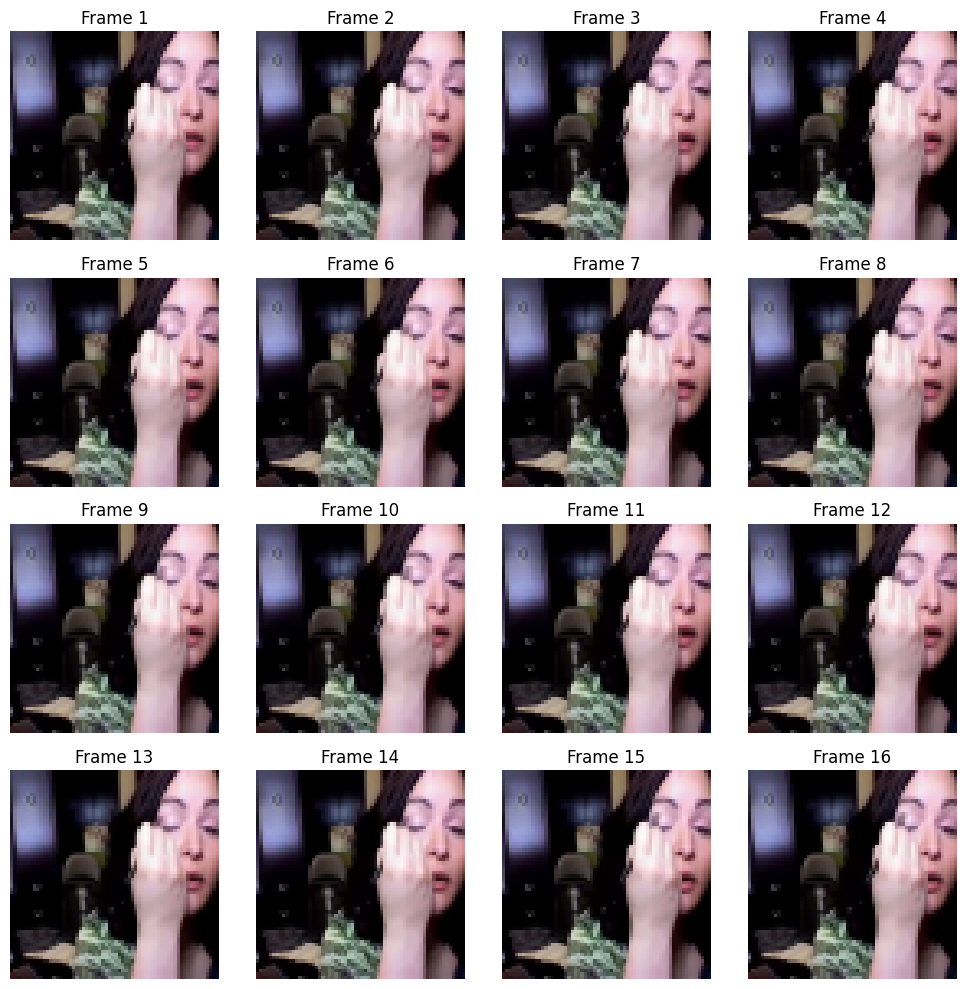

In [18]:
import torch
import matplotlib.pyplot as plt
import os

# Define path to a preprocessed video
processed_dir = '/kaggle/working/ucf101processed'
video_path = f'{processed_dir}/ApplyEyeMakeup/v_ApplyEyeMakeup_g01_c01.pt'

# Load the video tensor
try:
    video = torch.load(video_path)  # Shape: [16, 3, 64, 64]
    print(f"Video tensor shape: {video.shape}")

    # Denormalize from [-1, 1] to [0, 1] for display
    video = (video + 1) / 2  # Shape: [16, 3, 64, 64]

    # Plot 16 frames in a 4x4 grid
    plt.figure(figsize=(10, 10))
    for i in range(16):
        plt.subplot(4, 4, i + 1)
        frame = video[i].permute(1, 2, 0).numpy()  # [64, 64, 3] for display
        plt.imshow(frame)
        plt.title(f"Frame {i+1}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
except FileNotFoundError:
    print(f"Video not found at {video_path}. Check path or try another class.")
    # List available classes
    print("Available classes:")
    !ls {processed_dir}

## NEURAL ODEs AND GANs

Real videos shape: torch.Size([16, 3, 16, 64, 64])
Fake videos shape: torch.Size([16, 3, 16, 64, 64])
Epoch [0/300] Batch [0/10] D Loss: 1.3698, G Loss: 0.6153
Epoch [0/300] Batch [5/10] D Loss: 1.6776, G Loss: 0.8002
Epoch [1/300] Batch [0/10] D Loss: 0.6402, G Loss: 2.5644
Epoch [1/300] Batch [5/10] D Loss: 1.3514, G Loss: 1.9435
Epoch [2/300] Batch [0/10] D Loss: 0.6644, G Loss: 3.4397
Epoch [2/300] Batch [5/10] D Loss: 0.8980, G Loss: 3.4469
Epoch [3/300] Batch [0/10] D Loss: 0.5867, G Loss: 2.8655
Epoch [3/300] Batch [5/10] D Loss: 0.7267, G Loss: 4.6293
Epoch [4/300] Batch [0/10] D Loss: 0.8161, G Loss: 4.1393
Epoch [4/300] Batch [5/10] D Loss: 0.7618, G Loss: 3.8212
Epoch [5/300] Batch [0/10] D Loss: 0.6818, G Loss: 3.7301
Epoch [5/300] Batch [5/10] D Loss: 0.5528, G Loss: 4.8286
Epoch [6/300] Batch [0/10] D Loss: 0.4558, G Loss: 3.7992
Epoch [6/300] Batch [5/10] D Loss: 0.9825, G Loss: 2.3114
Epoch [7/300] Batch [0/10] D Loss: 0.5858, G Loss: 4.7889
Epoch [7/300] Batch [5/10] D

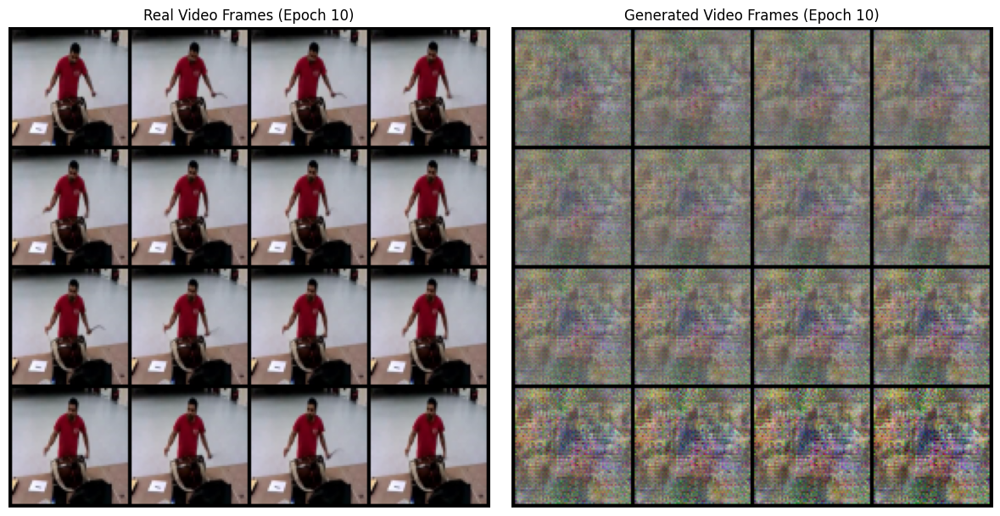

100%|██████████| 16/16 [00:00<00:00, 23.06it/s]


Epoch [11/300] Batch [0/10] D Loss: 0.6181, G Loss: 3.6609
Epoch [11/300] Batch [5/10] D Loss: 0.4413, G Loss: 4.1664
Epoch [12/300] Batch [0/10] D Loss: 1.2018, G Loss: 3.9998
Epoch [12/300] Batch [5/10] D Loss: 1.3773, G Loss: 3.3502
Epoch [13/300] Batch [0/10] D Loss: 0.6655, G Loss: 4.3837
Epoch [13/300] Batch [5/10] D Loss: 0.7681, G Loss: 1.7530
Epoch [14/300] Batch [0/10] D Loss: 0.7317, G Loss: 5.2844
Epoch [14/300] Batch [5/10] D Loss: 0.4509, G Loss: 3.7174
Epoch [15/300] Batch [0/10] D Loss: 0.5315, G Loss: 3.2698
Epoch [15/300] Batch [5/10] D Loss: 0.5144, G Loss: 4.2884
Epoch [16/300] Batch [0/10] D Loss: 0.4292, G Loss: 3.1315
Epoch [16/300] Batch [5/10] D Loss: 0.4408, G Loss: 4.1492
Epoch [17/300] Batch [0/10] D Loss: 0.3798, G Loss: 3.9805
Epoch [17/300] Batch [5/10] D Loss: 0.4992, G Loss: 3.8250
Epoch [18/300] Batch [0/10] D Loss: 0.5192, G Loss: 6.9125
Epoch [18/300] Batch [5/10] D Loss: 0.3657, G Loss: 4.7616
Epoch [19/300] Batch [0/10] D Loss: 0.3887, G Loss: 4.04

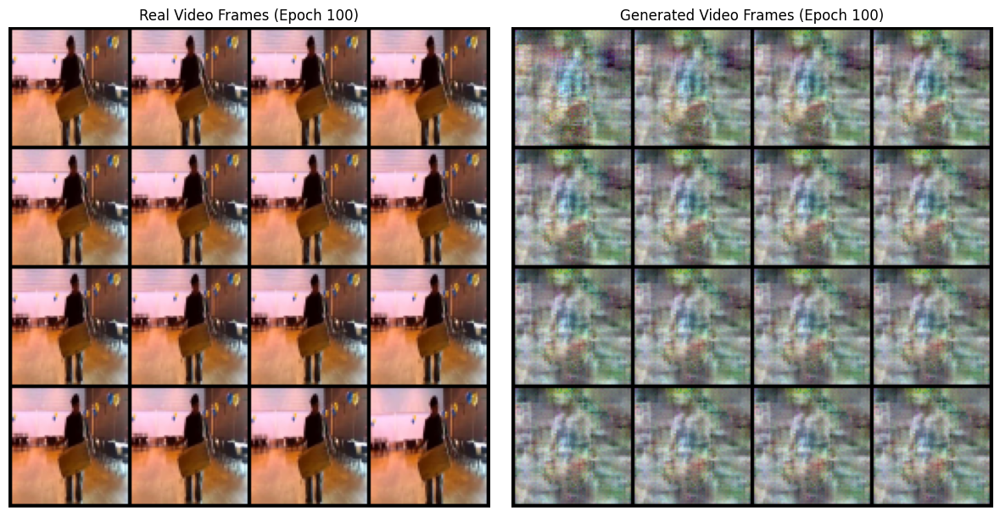

100%|██████████| 16/16 [00:00<00:00, 22.99it/s]


Epoch [101/300] Batch [0/10] D Loss: 0.4001, G Loss: 7.4549
Epoch [101/300] Batch [5/10] D Loss: 0.4132, G Loss: 5.5850
Epoch [102/300] Batch [0/10] D Loss: 0.3910, G Loss: 5.2057
Epoch [102/300] Batch [5/10] D Loss: 0.7268, G Loss: 1.5544
Epoch [103/300] Batch [0/10] D Loss: 1.3496, G Loss: 7.1292
Epoch [103/300] Batch [5/10] D Loss: 0.8521, G Loss: 4.2396
Epoch [104/300] Batch [0/10] D Loss: 0.9233, G Loss: 7.9130
Epoch [104/300] Batch [5/10] D Loss: 1.3134, G Loss: 6.7274
Epoch [105/300] Batch [0/10] D Loss: 1.7424, G Loss: 15.0953
Epoch [105/300] Batch [5/10] D Loss: 1.2446, G Loss: 7.2116
Epoch [106/300] Batch [0/10] D Loss: 0.9720, G Loss: 4.3720
Epoch [106/300] Batch [5/10] D Loss: 1.0945, G Loss: 5.6789
Epoch [107/300] Batch [0/10] D Loss: 0.6349, G Loss: 4.3576
Epoch [107/300] Batch [5/10] D Loss: 0.7766, G Loss: 5.4497
Epoch [108/300] Batch [0/10] D Loss: 0.4426, G Loss: 7.4830
Epoch [108/300] Batch [5/10] D Loss: 0.5900, G Loss: 8.3068
Epoch [109/300] Batch [0/10] D Loss: 0.

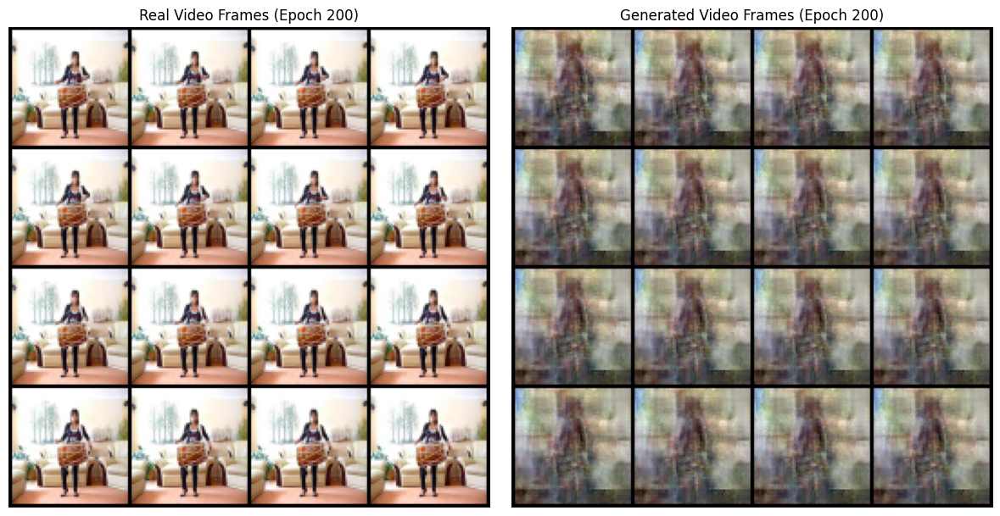

100%|██████████| 16/16 [00:00<00:00, 22.34it/s]


Epoch [201/300] Batch [0/10] D Loss: 0.4639, G Loss: 7.5622
Epoch [201/300] Batch [5/10] D Loss: 0.4369, G Loss: 5.1293
Epoch [202/300] Batch [0/10] D Loss: 0.5751, G Loss: 6.5620
Epoch [202/300] Batch [5/10] D Loss: 0.4176, G Loss: 4.0113
Epoch [203/300] Batch [0/10] D Loss: 0.4612, G Loss: 4.6085
Epoch [203/300] Batch [5/10] D Loss: 0.4253, G Loss: 4.2948
Epoch [204/300] Batch [0/10] D Loss: 0.4167, G Loss: 5.2508
Epoch [204/300] Batch [5/10] D Loss: 0.5307, G Loss: 6.7786
Epoch [205/300] Batch [0/10] D Loss: 0.3897, G Loss: 4.0857
Epoch [205/300] Batch [5/10] D Loss: 0.5117, G Loss: 3.8123
Epoch [206/300] Batch [0/10] D Loss: 0.5266, G Loss: 5.6537
Epoch [206/300] Batch [5/10] D Loss: 0.5291, G Loss: 7.3181
Epoch [207/300] Batch [0/10] D Loss: 0.4587, G Loss: 5.6138
Epoch [207/300] Batch [5/10] D Loss: 0.3716, G Loss: 6.9060
Epoch [208/300] Batch [0/10] D Loss: 0.4384, G Loss: 4.3455
Epoch [208/300] Batch [5/10] D Loss: 0.4519, G Loss: 5.3711
Epoch [209/300] Batch [0/10] D Loss: 0.3

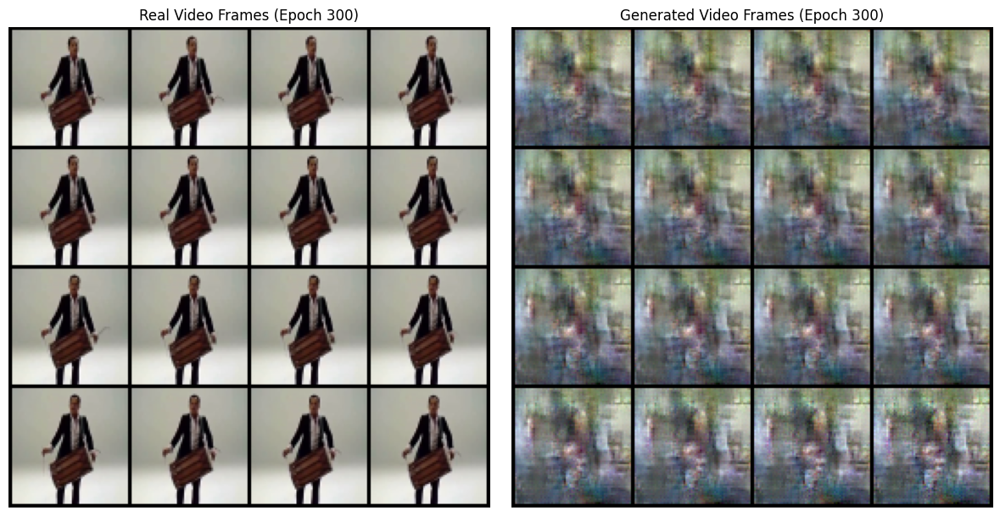

100%|██████████| 16/16 [00:00<00:00, 22.93it/s]



FID Scores:
Epoch 10: 502.92
Epoch 100: 468.33
Epoch 200: 443.06
Epoch 300: 486.00


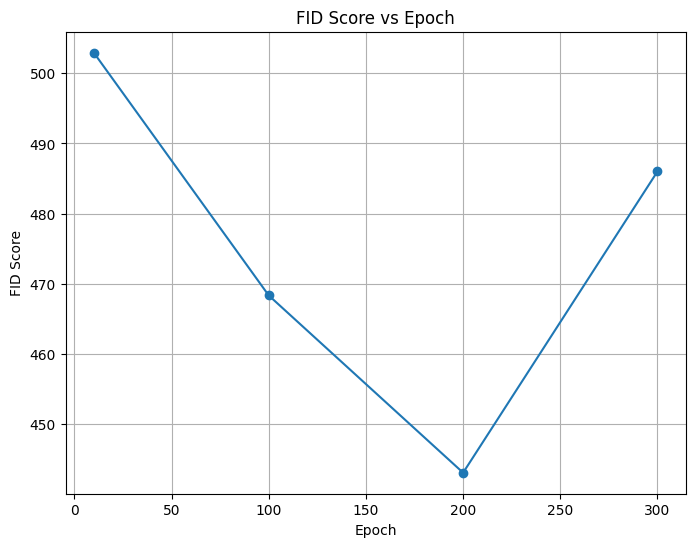

In [14]:
import torch
import torch.nn as nn
from torchdiffeq import odeint
from torch.utils.data import Dataset, DataLoader
import glob
import torch.optim as optim
from torchvision.utils import make_grid, save_image
import os
import sys
import matplotlib.pyplot as plt
from pytorch_fid import fid_score
import logging

# Set up logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger()

# Clear CUDA memory
torch.cuda.empty_cache()



# Dataset class
class UCF101Dataset(Dataset):
    def __init__(self, processed_dir, max_clips=160):
        self.video_paths = glob.glob(f'{processed_dir}/*/*.pt')[:max_clips]
        if not self.video_paths:
            raise ValueError(f"No .pt files in {processed_dir}")
        logger.info(f"Found {len(self.video_paths)} video files in {processed_dir}")

    def __len__(self):
        return len(self.video_paths)

    def __getitem__(self, idx):
        video = torch.load(self.video_paths[idx])
        logger.debug(f"Loaded video {self.video_paths[idx]} with shape {video.shape}")
        return video

# Set up DataLoader
processed_dir = '/kaggle/working/ucf101processed'
try:
    dataset = UCF101Dataset(processed_dir, max_clips=160)
    dataloader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)
    logger.info(f"DataLoader created with {len(dataloader)} batches")
except Exception as e:
    logger.error(f"Failed to create DataLoader: {e}")
    raise

# Neural ODE function
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim)
        )

    def forward(self, t, z):
        return self.net(z)

# Neural ODE-based Generator
class Generator(nn.Module):
    def __init__(self, z_dim, hidden_dim, video_shape):
        super().__init__()
        self.z_dim = z_dim
        self.video_shape = video_shape
        self.ode_func = ODEFunc(hidden_dim)
        self.initial = nn.Linear(z_dim, hidden_dim)
        self.decoder = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim * 4),
            nn.ReLU(),
            nn.Linear(hidden_dim * 4, video_shape[1] * video_shape[2] * video_shape[3])
        )

    def forward(self, z):
        batch_size = z.size(0)
        z0 = self.initial(z)
        t = torch.linspace(0, 1, self.video_shape[0]).to(z.device)
        zt = odeint(self.ode_func, z0, t, method='rk4')
        videos = []
        for i in range(zt.shape[0]):
            frame = self.decoder(zt[i]).view(batch_size, *self.video_shape[1:])
            videos.append(frame)
        video = torch.stack(videos, dim=2)
        return video

# Discriminator
class Discriminator(nn.Module):
    def __init__(self, video_shape, hidden_dim):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv3d(video_shape[1], hidden_dim, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv3d(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Flatten(),
            nn.Linear(hidden_dim * 2 * (video_shape[0] // 4) * (video_shape[2] // 4) * (video_shape[3] // 4), 1)
        )

    def forward(self, x):
        return self.net(x)

# FID computation function
def compute_fid(real_videos, fake_videos, save_dir='/kaggle/working/TGAN_ODE/fid', device='cuda'):
    try:
        logger.info(f"Computing FID at {save_dir}")
        real_videos = fix_shape(real_videos)
        fake_videos = fix_shape(fake_videos)
        logger.info(f"Real videos shape: {real_videos.shape}, Fake videos shape: {fake_videos.shape}")

        real_dir = os.path.join(save_dir, 'real')
        fake_dir = os.path.join(save_dir, 'fake')
        os.makedirs(real_dir, exist_ok=True)
        os.makedirs(fake_dir, exist_ok=True)

        # Clear directories
        for dir_path in [real_dir, fake_dir]:
            for f in glob.glob(f"{dir_path}/*.png"):
                os.remove(f)
        logger.info(f"Cleared {real_dir} and {fake_dir}")

        # Save frames
        for i in range(real_videos.size(0)):
            for t in range(real_videos.size(1)):
                real_frame = real_videos[i, t]
                fake_frame = fake_videos[i, t]
                if real_frame.shape != (3, 64, 64) or fake_frame.shape != (3, 64, 64):
                    logger.error(f"Invalid frame shape at i={i}, t={t}: real={real_frame.shape}, fake={fake_frame.shape}")
                    raise ValueError(f"Invalid frame shape")
                save_image(real_frame, f"{real_dir}/{i}_{t}.png", normalize=True)
                save_image(fake_frame, f"{fake_dir}/{i}_{t}.png", normalize=True)

        # Verify images
        real_images = glob.glob(f"{real_dir}/*.png")
        fake_images = glob.glob(f"{fake_dir}/*.png")
        logger.info(f"Saved {len(real_images)} real images, {len(fake_images)} fake images")
        if len(real_images) < 16 or len(fake_images) < 16:
            logger.error(f"Insufficient images: real={len(real_images)}, fake={len(fake_images)}")
            raise ValueError(f"Insufficient images saved")

        # Compute FID
        fid = fid_score.calculate_fid_given_paths(
            [real_dir, fake_dir],
            batch_size=16,
            device=device,
            dims=2048
        )
        logger.info(f"Computed FID: {fid:.2f}")
        return fid
    except Exception as e:
        logger.error(f"FID computation failed: {str(e)}")
        raise

# Fix video shape
def fix_shape(x):
    if x.shape[1] == 3:
        return x.permute(0, 2, 1, 3, 4).contiguous()
    return x

# Display 16 frames
def display_real_vs_fake(real_videos, fake_videos, epoch, clip_idx=0):
    real_videos = fix_shape(real_videos)
    fake_videos = fix_shape(fake_videos)
    real_clip = real_videos[clip_idx]
    fake_clip = fake_videos[clip_idx]
    real_grid = make_grid(real_clip, nrow=4, normalize=True)
    fake_grid = make_grid(fake_clip, nrow=4, normalize=True)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(real_grid.permute(1, 2, 0).cpu().numpy())
    plt.title(f"Real Video Frames (Epoch {epoch})")
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(fake_grid.permute(1, 2, 0).cpu().numpy())
    plt.title(f"Generated Video Frames (Epoch {epoch})")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Model parameters
z_dim = 100
hidden_dim = 256
video_shape = (16, 3, 64, 64)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize models
generator = Generator(z_dim, hidden_dim, video_shape).to(device)
discriminator = Discriminator(video_shape, hidden_dim).to(device)

# Loss and optimizers
criterion = nn.BCEWithLogitsLoss()
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
real_label = 0.9
fake_label = 0.0

# Training loop
num_epochs = 300
fid_scores = []
fid_epochs = [10, 100, 200, 300]

for epoch in range(num_epochs + 1):
    logger.info(f"Starting epoch {epoch}")
    for i, batch in enumerate(dataloader):
        real_videos = batch.to(device)
        real_videos = real_videos.permute(0, 2, 1, 3, 4).contiguous()
        batch_size = real_videos.size(0)
        z = torch.randn(batch_size, z_dim).to(device)
        fake_videos = generator(z)
        if i == 0 and epoch == 0:
            print(f"Real videos shape: {real_videos.shape}")
            print(f"Fake videos shape: {fake_videos.shape}")
        discriminator.zero_grad()
        real_output = discriminator(real_videos)
        real_loss = criterion(real_output, torch.full_like(real_output, real_label))
        fake_output = discriminator(fake_videos.detach())
        fake_loss = criterion(fake_output, torch.full_like(fake_output, fake_label))
        d_loss = real_loss + fake_loss
        d_loss.backward()
        d_optimizer.step()
        generator.zero_grad()
        fake_output = discriminator(fake_videos)
        g_loss = criterion(fake_output, torch.full_like(fake_output, real_label))
        g_loss.backward()
        g_optimizer.step()
        if i % 5 == 0:
            print(f"Epoch [{epoch}/{num_epochs}] Batch [{i}/{len(dataloader)}] "
                  f"D Loss: {d_loss.item():.4f}, G Loss: {g_loss.item():.4f}")
        torch.cuda.empty_cache()
    if epoch in fid_epochs:
        logger.info(f"Computing FID for epoch {epoch}")
        with torch.no_grad():
            for batch in dataloader:
                if batch.size(0) < 16:
                    logger.warning(f"Skipping batch with size {batch.size(0)}")
                    continue
                real_videos = batch.to(device)[:16]
                real_videos = real_videos.permute(0, 2, 1, 3, 4).contiguous()
                z = torch.randn(16, z_dim).to(device)
                fake_videos = generator(z)
                display_real_vs_fake(real_videos, fake_videos, epoch)
                try:
                    fid = compute_fid(real_videos, fake_videos, device=device)
                    fid_scores.append((epoch, fid))
                    logger.info(f"Stored FID for epoch {epoch}: {fid:.2f}")
                except Exception as e:
                    logger.error(f"FID error at epoch {epoch}: {e}")
                break

# Save models
os.makedirs('/kaggle/working/TGAN_ODE', exist_ok=True)
torch.save(generator.state_dict(), '/kaggle/working/TGAN_ODE/generator.pth')
torch.save(discriminator.state_dict(), '/kaggle/working/TGAN_ODE/discriminator.pth')

# Print all FID scores
print("\nFID Scores:")
if not fid_scores:
    print("No FID scores were calculated.")
for epoch, fid in fid_scores:
    print(f"Epoch {epoch}: {fid:.2f}")

# Plot FID scores
plt.figure(figsize=(8, 6))
epochs, fids = zip(*fid_scores) if fid_scores else ([], [])
plt.plot(epochs, fids, marker='o')
plt.xlabel('Epoch')
plt.ylabel('FID Score')
plt.title('FID Score vs Epoch')
plt.grid(True)
plt.show()


## RESNET+GANs

Real videos shape: torch.Size([16, 3, 16, 64, 64])
Fake videos shape: torch.Size([16, 3, 16, 64, 64])
Epoch [0/300] Batch [0/10] D Loss: 1.3744, G Loss: 1.0637
Epoch [0/300] Batch [5/10] D Loss: 1.8823, G Loss: 0.9730
Epoch [1/300] Batch [0/10] D Loss: 0.6994, G Loss: 4.4818
Epoch [1/300] Batch [5/10] D Loss: 2.5578, G Loss: 3.9959
Epoch [2/300] Batch [0/10] D Loss: 1.0618, G Loss: 2.6503
Epoch [2/300] Batch [5/10] D Loss: 0.8437, G Loss: 1.8261
Epoch [3/300] Batch [0/10] D Loss: 0.7888, G Loss: 2.6215
Epoch [3/300] Batch [5/10] D Loss: 2.3272, G Loss: 11.8382
Epoch [4/300] Batch [0/10] D Loss: 0.8819, G Loss: 2.1361
Epoch [4/300] Batch [5/10] D Loss: 1.3430, G Loss: 7.1489
Epoch [5/300] Batch [0/10] D Loss: 0.5770, G Loss: 3.2934
Epoch [5/300] Batch [5/10] D Loss: 0.4149, G Loss: 3.8309
Epoch [6/300] Batch [0/10] D Loss: 0.4175, G Loss: 4.6408
Epoch [6/300] Batch [5/10] D Loss: 0.9297, G Loss: 11.3594
Epoch [7/300] Batch [0/10] D Loss: 2.9344, G Loss: 9.4534
Epoch [7/300] Batch [5/10]

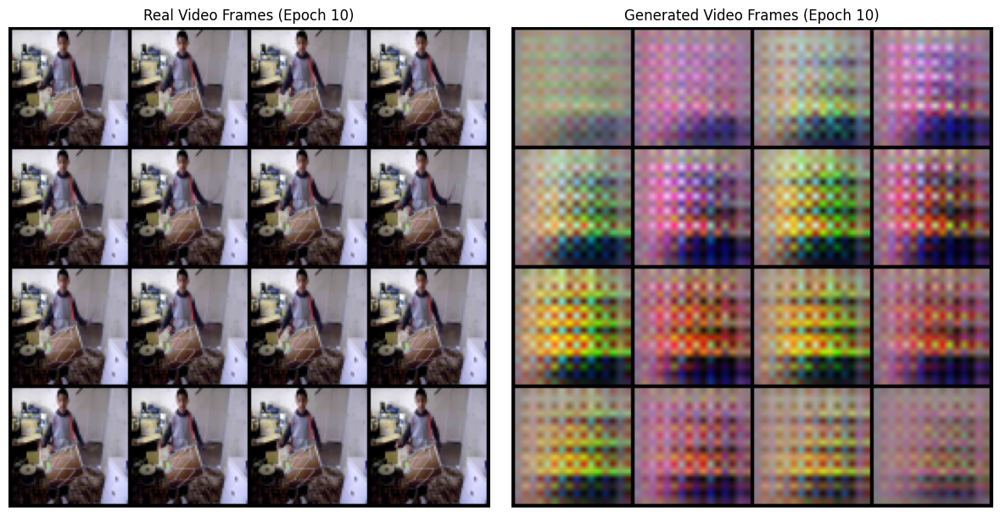

100%|██████████| 8/8 [00:00<00:00, 12.22it/s]


Epoch [11/300] Batch [0/10] D Loss: 1.5000, G Loss: 16.2442
Epoch [11/300] Batch [5/10] D Loss: 0.7126, G Loss: 3.4868
Epoch [12/300] Batch [0/10] D Loss: 1.1569, G Loss: 8.9441
Epoch [12/300] Batch [5/10] D Loss: 1.7837, G Loss: 5.4497
Epoch [13/300] Batch [0/10] D Loss: 2.4043, G Loss: 13.9813
Epoch [13/300] Batch [5/10] D Loss: 3.0677, G Loss: 13.8446
Epoch [14/300] Batch [0/10] D Loss: 1.7163, G Loss: 3.4902
Epoch [14/300] Batch [5/10] D Loss: 3.6145, G Loss: 5.9368
Epoch [15/300] Batch [0/10] D Loss: 2.5010, G Loss: 2.5953
Epoch [15/300] Batch [5/10] D Loss: 1.5737, G Loss: 10.2187
Epoch [16/300] Batch [0/10] D Loss: 0.6698, G Loss: 3.2859
Epoch [16/300] Batch [5/10] D Loss: 0.6886, G Loss: 3.6989
Epoch [17/300] Batch [0/10] D Loss: 0.5181, G Loss: 3.7100
Epoch [17/300] Batch [5/10] D Loss: 0.7830, G Loss: 3.0777
Epoch [18/300] Batch [0/10] D Loss: 5.2694, G Loss: 9.3449
Epoch [18/300] Batch [5/10] D Loss: 3.1636, G Loss: 20.9789
Epoch [19/300] Batch [0/10] D Loss: 13.9486, G Loss

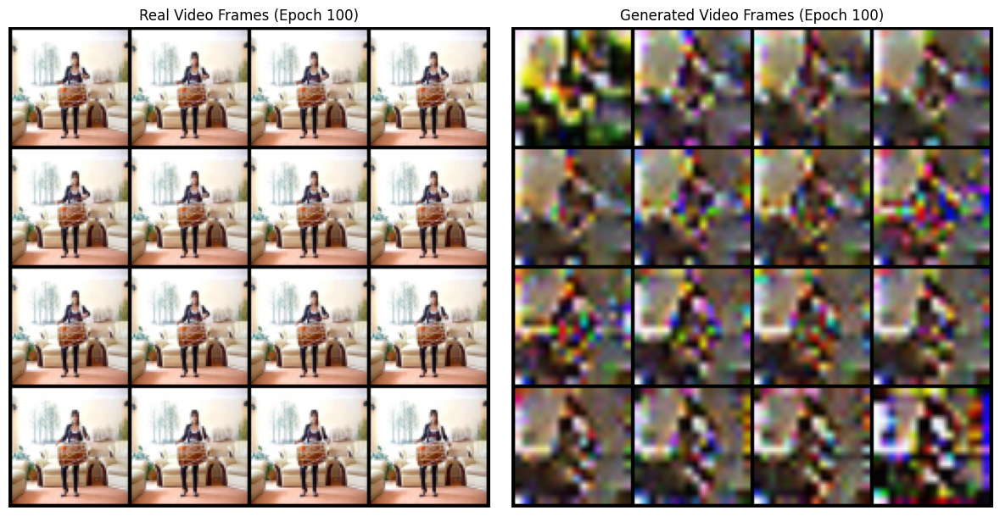

100%|██████████| 8/8 [00:00<00:00, 12.30it/s]


Epoch [101/300] Batch [0/10] D Loss: 0.3288, G Loss: 6.2023
Epoch [101/300] Batch [5/10] D Loss: 0.3357, G Loss: 6.2298
Epoch [102/300] Batch [0/10] D Loss: 0.3373, G Loss: 6.3896
Epoch [102/300] Batch [5/10] D Loss: 0.3368, G Loss: 6.4014
Epoch [103/300] Batch [0/10] D Loss: 0.3299, G Loss: 6.3834
Epoch [103/300] Batch [5/10] D Loss: 0.3325, G Loss: 6.2943
Epoch [104/300] Batch [0/10] D Loss: 0.3478, G Loss: 6.4818
Epoch [104/300] Batch [5/10] D Loss: 0.3315, G Loss: 5.9167
Epoch [105/300] Batch [0/10] D Loss: 0.3358, G Loss: 5.7719
Epoch [105/300] Batch [5/10] D Loss: 0.3592, G Loss: 5.3580
Epoch [106/300] Batch [0/10] D Loss: 0.3520, G Loss: 6.1340
Epoch [106/300] Batch [5/10] D Loss: 0.3575, G Loss: 6.0246
Epoch [107/300] Batch [0/10] D Loss: 0.3603, G Loss: 6.1325
Epoch [107/300] Batch [5/10] D Loss: 0.3897, G Loss: 5.9461
Epoch [108/300] Batch [0/10] D Loss: 0.3505, G Loss: 5.8174
Epoch [108/300] Batch [5/10] D Loss: 0.4113, G Loss: 5.5819
Epoch [109/300] Batch [0/10] D Loss: 0.3

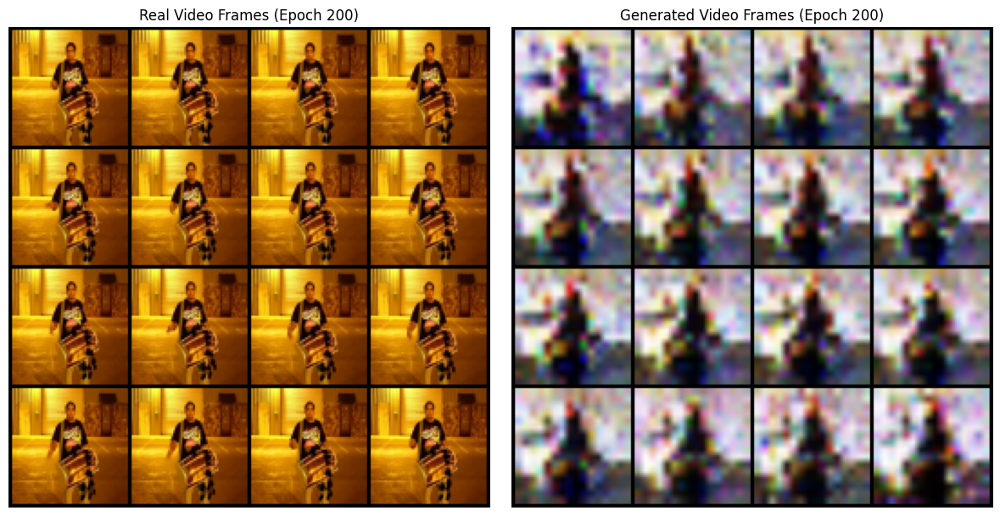

100%|██████████| 8/8 [00:00<00:00, 12.48it/s]


Epoch [201/300] Batch [0/10] D Loss: 0.3659, G Loss: 4.5866
Epoch [201/300] Batch [5/10] D Loss: 0.3396, G Loss: 5.5879
Epoch [202/300] Batch [0/10] D Loss: 0.3492, G Loss: 5.0692
Epoch [202/300] Batch [5/10] D Loss: 0.4675, G Loss: 4.2779
Epoch [203/300] Batch [0/10] D Loss: 0.3489, G Loss: 5.3002
Epoch [203/300] Batch [5/10] D Loss: 0.3424, G Loss: 5.4747
Epoch [204/300] Batch [0/10] D Loss: 0.3570, G Loss: 5.5923
Epoch [204/300] Batch [5/10] D Loss: 0.3690, G Loss: 4.9378
Epoch [205/300] Batch [0/10] D Loss: 0.3516, G Loss: 5.1333
Epoch [205/300] Batch [5/10] D Loss: 0.3404, G Loss: 5.2137
Epoch [206/300] Batch [0/10] D Loss: 0.3455, G Loss: 5.5487
Epoch [206/300] Batch [5/10] D Loss: 0.3289, G Loss: 5.8734
Epoch [207/300] Batch [0/10] D Loss: 0.3542, G Loss: 5.6759
Epoch [207/300] Batch [5/10] D Loss: 0.3315, G Loss: 5.8436
Epoch [208/300] Batch [0/10] D Loss: 0.3316, G Loss: 5.6551
Epoch [208/300] Batch [5/10] D Loss: 0.3523, G Loss: 5.6311
Epoch [209/300] Batch [0/10] D Loss: 0.3

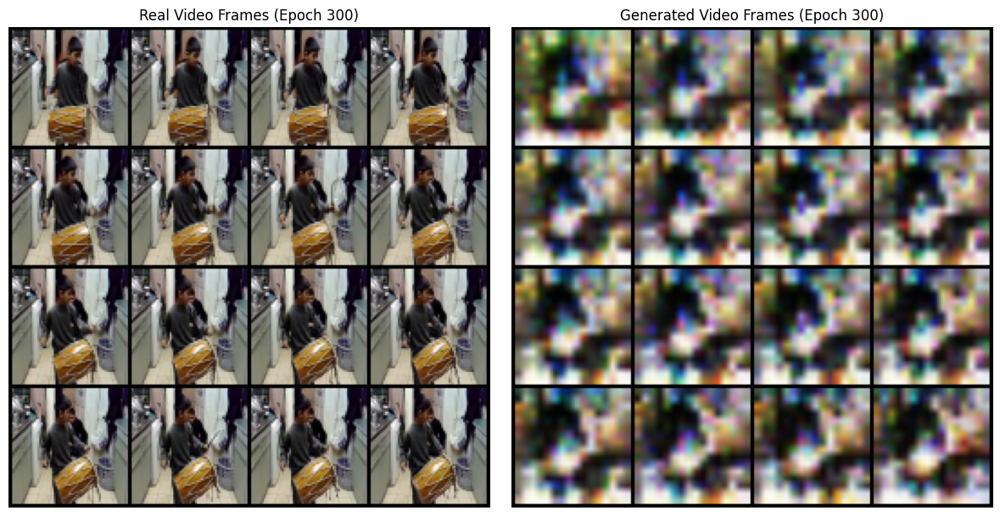

100%|██████████| 8/8 [00:00<00:00, 12.46it/s]



FID Scores:
Epoch 10: 425.42
Epoch 100: 391.66
Epoch 200: 380.04
Epoch 300: 365.87


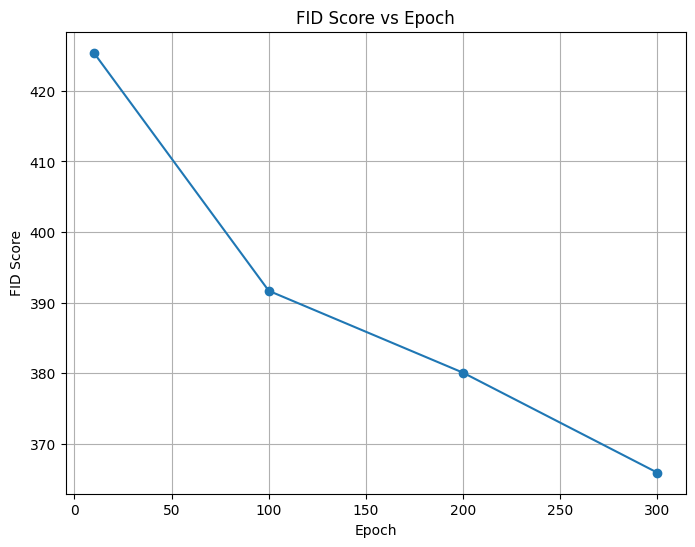

In [17]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import glob
import torch.optim as optim
from torchvision.utils import make_grid, save_image
import os
import sys
import matplotlib.pyplot as plt
from pytorch_fid import fid_score
import logging

# Set up logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger()

# Clear CUDA memory
torch.cuda.empty_cache()


# Dataset class with limited clips
class UCF101Dataset(Dataset):
    def __init__(self, processed_dir, max_clips=160):
        self.video_paths = glob.glob(f'{processed_dir}/*/*.pt')[:max_clips]
        if not self.video_paths:
            raise ValueError(f"No .pt files in {processed_dir}")
        logger.info(f"Found {len(self.video_paths)} video files in {processed_dir}")

    def __len__(self):
        return len(self.video_paths)

    def __getitem__(self, idx):
        video = torch.load(self.video_paths[idx])
        logger.debug(f"Loaded video {self.video_paths[idx]} with shape {video.shape}")
        return video

# Set up DataLoader
processed_dir = '/kaggle/working/ucf101processed'
try:
    dataset = UCF101Dataset(processed_dir, max_clips=160)
    dataloader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)
    logger.info(f"DataLoader created with {len(dataloader)} batches")
except Exception as e:
    logger.error(f"Failed to create DataLoader: {e}")
    raise

# ResNet Block for 3D convolutions
class ResNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv1 = nn.Conv3d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm3d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv3d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm3d(out_channels)
        self.shortcut = nn.Sequential()
        if in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv3d(in_channels, out_channels, kernel_size=1, stride=1),
                nn.BatchNorm3d(out_channels)
            )

    def forward(self, x):
        identity = self.shortcut(x)
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out += identity
        out = self.relu(out)
        return out

# ResNet-based Generator
class Generator(nn.Module):
    def __init__(self, z_dim, video_shape, hidden_dim=64):
        super().__init__()
        self.z_dim = z_dim
        self.video_shape = video_shape
        self.initial = nn.Linear(z_dim, hidden_dim * 4 * 4 * 4)
        self.initial_bn = nn.BatchNorm3d(hidden_dim)
        self.relu = nn.ReLU(inplace=True)
        self.resnet_blocks = nn.Sequential(
            ResNetBlock(hidden_dim, hidden_dim),
            ResNetBlock(hidden_dim, hidden_dim * 2),
            nn.ConvTranspose3d(hidden_dim * 2, hidden_dim, kernel_size=4, stride=2, padding=1, output_padding=0),
            nn.BatchNorm3d(hidden_dim),
            nn.ReLU(inplace=True),
            ResNetBlock(hidden_dim, hidden_dim),
            nn.ConvTranspose3d(hidden_dim, hidden_dim // 2, kernel_size=4, stride=2, padding=1, output_padding=0),
            nn.BatchNorm3d(hidden_dim // 2),
            nn.ReLU(inplace=True),
        )
        self.final_conv = nn.Conv3d(hidden_dim // 2, video_shape[1], kernel_size=3, stride=1, padding=1)
        self.tanh = nn.Tanh()

    def forward(self, z):
        batch_size = z.size(0)
        x = self.initial(z).view(batch_size, 64, 4, 4, 4)
        x = self.initial_bn(x)
        x = self.relu(x)
        x = self.resnet_blocks(x)
        x = self.final_conv(x)
        x = self.tanh(x)
        x = nn.functional.interpolate(x, size=(self.video_shape[0], self.video_shape[2], self.video_shape[3]), mode='trilinear', align_corners=False)
        return x

# Discriminator
class Discriminator(nn.Module):
    def __init__(self, video_shape, hidden_dim):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv3d(video_shape[1], hidden_dim, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv3d(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Flatten(),
            nn.Linear(hidden_dim * 2 * (video_shape[0] // 4) * (video_shape[2] // 4) * (video_shape[3] // 4), 1)
        )

    def forward(self, x):
        return self.net(x)

# FID computation function with enhanced debugging
def compute_fid(real_videos, fake_videos, save_dir='/kaggle/working/TGAN_ResNet/fid', device='cuda'):
    try:
        logger.info(f"Computing FID at {save_dir}")
        real_videos = fix_shape(real_videos)
        fake_videos = fix_shape(fake_videos)
        logger.info(f"Real videos shape: {real_videos.shape}, Fake videos shape: {fake_videos.shape}")

        real_dir = os.path.join(save_dir, 'real')
        fake_dir = os.path.join(save_dir, 'fake')
        os.makedirs(real_dir, exist_ok=True)
        os.makedirs(fake_dir, exist_ok=True)

        # Clear directories to avoid stale images
        for dir_path in [real_dir, fake_dir]:
            for f in glob.glob(f"{dir_path}/*.png"):
                os.remove(f)
        logger.info(f"Cleared {real_dir} and {fake_dir}")

        # Save frames
        for i in range(real_videos.size(0)):
            for t in range(real_videos.size(1)):
                real_frame = real_videos[i, t]
                fake_frame = fake_videos[i, t]
                if real_frame.shape != (3, 64, 64) or fake_frame.shape != (3, 64, 64):
                    logger.error(f"Invalid frame shape at i={i}, t={t}: real={real_frame.shape}, fake={fake_frame.shape}")
                    raise ValueError(f"Invalid frame shape")
                save_image(real_frame, f"{real_dir}/{i}_{t}.png", normalize=True)
                save_image(fake_frame, f"{fake_dir}/{i}_{t}.png", normalize=True)

        # Verify saved images
        real_images = glob.glob(f"{real_dir}/*.png")
        fake_images = glob.glob(f"{fake_dir}/*.png")
        logger.info(f"Saved {len(real_images)} real images, {len(fake_images)} fake images")
        if len(real_images) < 16 or len(fake_images) < 16:
            logger.error(f"Insufficient images: real={len(real_images)}, fake={len(fake_images)}")
            raise ValueError(f"Insufficient images saved")

        # Compute FID
        fid = fid_score.calculate_fid_given_paths(
            [real_dir, fake_dir],
            batch_size=32,
            device=device,
            dims=2048
        )
        logger.info(f"Computed FID: {fid:.2f}")
        return fid
    except Exception as e:
        logger.error(f"FID computation failed: {str(e)}")
        raise

# Fix video shape
def fix_shape(x):
    if x.shape[1] == 3:
        return x.permute(0, 2, 1, 3, 4).contiguous()
    return x

# Display 16 frames
def display_real_vs_fake(real_videos, fake_videos, epoch, clip_idx=0):
    real_videos = fix_shape(real_videos)
    fake_videos = fix_shape(fake_videos)
    real_clip = real_videos[clip_idx]
    fake_clip = fake_videos[clip_idx]
    real_grid = make_grid(real_clip, nrow=4, normalize=True)
    fake_grid = make_grid(fake_clip, nrow=4, normalize=True)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(real_grid.permute(1, 2, 0).cpu().numpy())
    plt.title(f"Real Video Frames (Epoch {epoch})")
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(fake_grid.permute(1, 2, 0).cpu().numpy())
    plt.title(f"Generated Video Frames (Epoch {epoch})")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Model parameters
z_dim = 100
hidden_dim = 256
video_shape = (16, 3, 64, 64)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize models
generator = Generator(z_dim, video_shape, hidden_dim=64).to(device)
discriminator = Discriminator(video_shape, hidden_dim).to(device)

# Loss and optimizers
criterion = nn.BCEWithLogitsLoss()
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
real_label = 0.9
fake_label = 0.0

# Training loop
num_epochs = 300
fid_scores = []
fid_epochs = [10, 100, 200, 300]

for epoch in range(num_epochs + 1):
    logger.info(f"Starting epoch {epoch}")
    for i, batch in enumerate(dataloader):
        real_videos = batch.to(device)
        real_videos = real_videos.permute(0, 2, 1, 3, 4).contiguous()
        batch_size = real_videos.size(0)
        z = torch.randn(batch_size, z_dim).to(device)
        fake_videos = generator(z)
        if i == 0 and epoch == 0:
            print(f"Real videos shape: {real_videos.shape}")
            print(f"Fake videos shape: {fake_videos.shape}")
        discriminator.zero_grad()
        real_output = discriminator(real_videos)
        real_loss = criterion(real_output, torch.full_like(real_output, real_label))
        fake_output = discriminator(fake_videos.detach())
        fake_loss = criterion(fake_output, torch.full_like(fake_output, fake_label))
        d_loss = real_loss + fake_loss
        d_loss.backward()
        d_optimizer.step()
        generator.zero_grad()
        fake_output = discriminator(fake_videos)
        g_loss = criterion(fake_output, torch.full_like(fake_output, real_label))
        g_loss.backward()
        g_optimizer.step()
        if i % 5 == 0:
            print(f"Epoch [{epoch}/{num_epochs}] Batch [{i}/{len(dataloader)}] "
                  f"D Loss: {d_loss.item():.4f}, G Loss: {g_loss.item():.4f}")
        torch.cuda.empty_cache()
    if epoch in fid_epochs:
        logger.info(f"Computing FID for epoch {epoch}")
        with torch.no_grad():
            for batch in dataloader:
                if batch.size(0) < 16:
                    logger.warning(f"Skipping batch with size {batch.size(0)}")
                    continue
                real_videos = batch.to(device)[:16]
                real_videos = real_videos.permute(0, 2, 1, 3, 4).contiguous()
                z = torch.randn(16, z_dim).to(device)
                fake_videos = generator(z)
                display_real_vs_fake(real_videos, fake_videos, epoch)
                try:
                    fid = compute_fid(real_videos, fake_videos, device=device)
                    fid_scores.append((epoch, fid))
                    logger.info(f"Stored FID for epoch {epoch}: {fid:.2f}")
                except Exception as e:
                    logger.error(f"FID error at epoch {epoch}: {e}")
                break

# Save models
os.makedirs('/kaggle/working/TGAN_ResNet', exist_ok=True)
torch.save(generator.state_dict(), '/kaggle/working/TGAN_ResNet/generator.pth')
torch.save(discriminator.state_dict(), '/kaggle/working/TGAN_ResNet/discriminator.pth')

# Print all FID scores
print("\nFID Scores:")
if not fid_scores:
    print("No FID scores were calculated.")
for epoch, fid in fid_scores:
    print(f"Epoch {epoch}: {fid:.2f}")

# Plot FID scores
plt.figure(figsize=(8, 6))
epochs, fids = zip(*fid_scores) if fid_scores else ([], [])
plt.plot(epochs, fids, marker='o')
plt.xlabel('Epoch')
plt.ylabel('FID Score')
plt.title('FID Score vs Epoch')
plt.grid(True)
plt.show()


## HYBRID MODEL (NEURAL ODE AND RESNET)

Starting training on device: cuda
Generator parameters: 6,619,971
Discriminator parameters: 8,962,817

--- Shape Check (Epoch 1, Batch 0) ---
Real videos batch shape (from DataLoader): torch.Size([16, 16, 3, 64, 64])
Real videos shape (after permute, input to Discriminator): torch.Size([16, 3, 16, 64, 64])
Fake videos shape (output of Generator, input to Discriminator): torch.Size([16, 3, 16, 64, 64])
--- End Shape Check ---

Epoch 10 - D_loss: 0.9334, G_loss: 4.0862


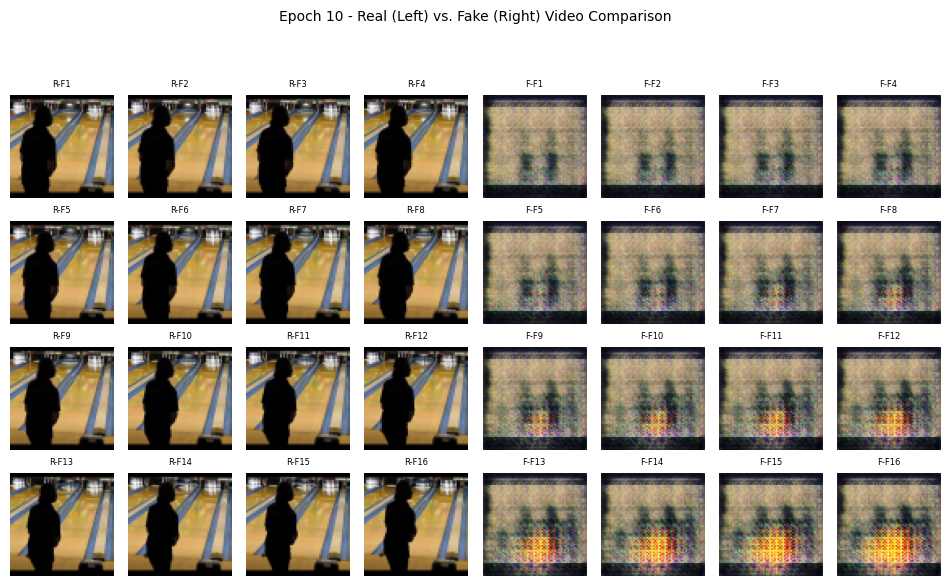

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:04<00:00, 20.6MB/s]
100%|██████████| 4/4 [00:00<00:00,  8.57it/s]


Epoch 10: Avg SSIM = 0.1060, FID = 437.8653
Epoch 20 - D_loss: 0.9346, G_loss: 2.4031
Epoch 30 - D_loss: 2.3723, G_loss: 4.7314
Epoch 40 - D_loss: 3.6756, G_loss: 5.4152
Epoch 50 - D_loss: 1.1065, G_loss: 6.4242
Epoch 60 - D_loss: 0.8611, G_loss: 4.7261
Epoch 70 - D_loss: 3.3572, G_loss: 3.6185
Epoch 80 - D_loss: 1.1075, G_loss: 7.0329
Epoch 90 - D_loss: 1.2807, G_loss: 3.9933
Epoch 100 - D_loss: 0.4733, G_loss: 5.7177


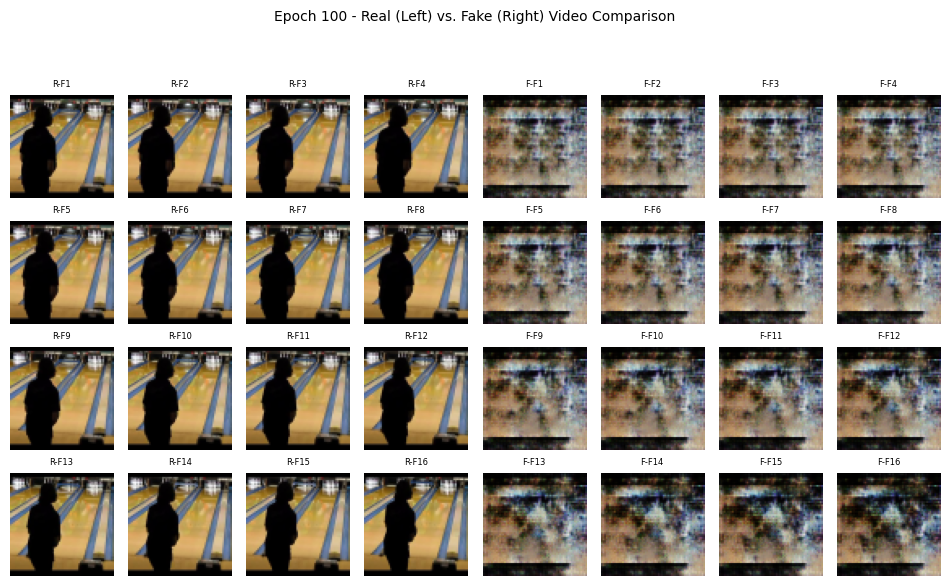

100%|██████████| 4/4 [00:00<00:00,  8.52it/s]


Epoch 100: Avg SSIM = 0.0836, FID = 429.1885
Epoch 110 - D_loss: 2.3916, G_loss: 10.7598
Epoch 120 - D_loss: 2.0647, G_loss: 12.4653
Epoch 130 - D_loss: 0.6124, G_loss: 2.7949
Epoch 140 - D_loss: 1.7333, G_loss: 9.6382
Epoch 150 - D_loss: 0.3915, G_loss: 10.7273
Epoch 160 - D_loss: 0.3567, G_loss: 5.2053
Epoch 170 - D_loss: 0.5867, G_loss: 4.8489
Epoch 180 - D_loss: 1.6968, G_loss: 12.6920
Epoch 190 - D_loss: 0.7516, G_loss: 8.4489
Epoch 200 - D_loss: 1.0077, G_loss: 6.6815


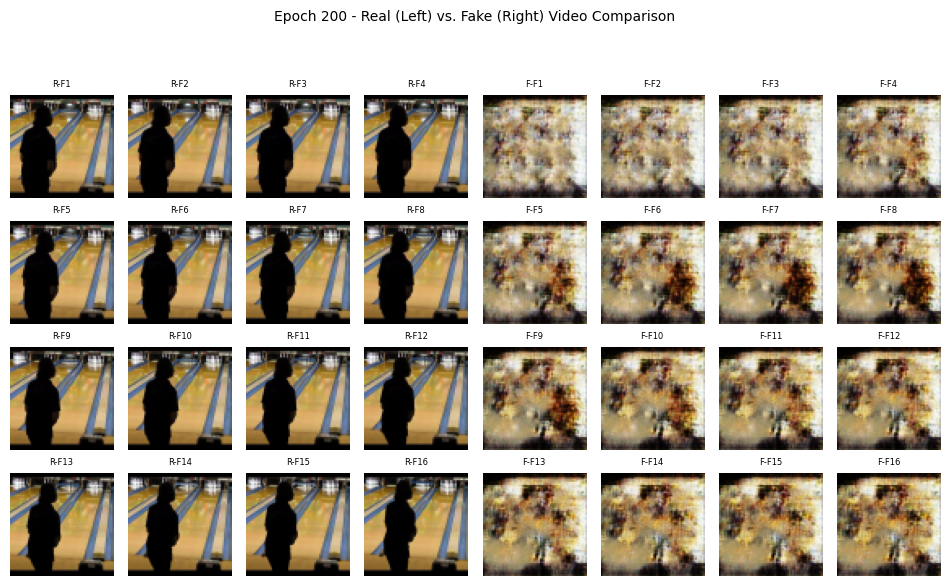

100%|██████████| 4/4 [00:00<00:00,  8.38it/s]


Epoch 200: Avg SSIM = 0.0630, FID = 438.5359
Epoch 210 - D_loss: 0.8416, G_loss: 15.2304
Epoch 220 - D_loss: 0.7411, G_loss: 12.8141
Epoch 230 - D_loss: 0.0017, G_loss: 14.3798
Epoch 240 - D_loss: 0.3839, G_loss: 4.9312
Epoch 250 - D_loss: 0.5363, G_loss: 3.7079
Epoch 260 - D_loss: 1.3128, G_loss: 11.1310
Epoch 270 - D_loss: 1.4107, G_loss: 21.5678
Epoch 280 - D_loss: 0.1480, G_loss: 3.8761
Epoch 290 - D_loss: 0.4939, G_loss: 11.1995
Epoch 300 - D_loss: 1.2451, G_loss: 7.8245


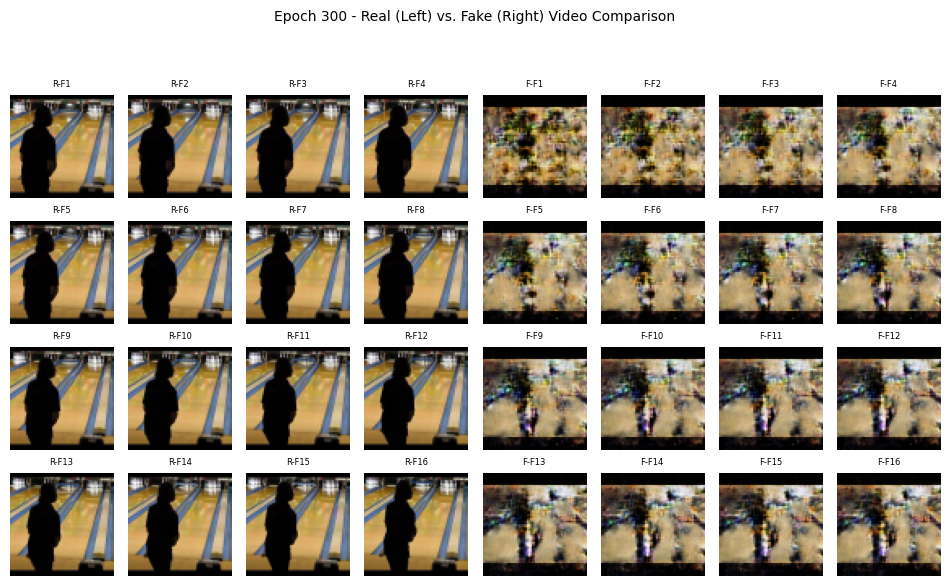

100%|██████████| 4/4 [00:00<00:00,  8.37it/s]


Epoch 300: Avg SSIM = 0.1234, FID = 420.5988

--- Final Evaluation Results ---
Epoch 10: SSIM = 0.1060, FID = 437.8653
Epoch 100: SSIM = 0.0836, FID = 429.1885
Epoch 200: SSIM = 0.0630, FID = 438.5359
Epoch 300: SSIM = 0.1234, FID = 420.5988


In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchdiffeq import odeint
from torch.utils.data import DataLoader, Subset, Dataset
import torchvision.models as models
from skimage.metrics import structural_similarity as ssim
import numpy as np
from pytorch_fid import fid_score
import os
import glob
import logging
from PIL import Image # For saving images in FID calculation
import matplotlib.pyplot as plt # Import matplotlib for plotting

# Setup logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Dataset class for loading UCF101 video clips
class UCF101Dataset(Dataset):
    def __init__(self, processed_dir, max_clips=160):
        # Glob for all .pt files within subdirectories of processed_dir
        self.video_paths = glob.glob(f'{processed_dir}/*/*.pt')[:max_clips]
        if not self.video_paths:
            raise ValueError(f"No .pt files found in {processed_dir}. Please ensure data is preprocessed.")
        logger.info(f"Found {len(self.video_paths)} videos for the dataset.")

    def __len__(self):
        return len(self.video_paths)

    def __getitem__(self, idx):
        # Each video clip is expected to be a PyTorch tensor
        # with shape (frames, channels, height, width), e.g., (16, 3, 64, 64)
        return torch.load(self.video_paths[idx])


# Neural ODE function to learn continuous dynamics
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super().__init__()
        # A simple MLP to define the derivative dz/dt = net(z)
        self.net = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim)
        )
    def forward(self, t, z):
        # t is time, z is the latent state
        return self.net(z)

# Custom Residual Block for the Generator's decoder
class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        # First convolutional layer
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        # Second convolutional layer
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)

        # Shortcut connection: 1x1 conv if input/output channels differ, otherwise identity
        self.shortcut = nn.Sequential()
        if in_channels != out_channels:
            self.shortcut = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1)

    def forward(self, x):
        identity = x # Store input for shortcut connection
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)

        out += self.shortcut(identity) # Add shortcut to main path
        out = self.relu(out)
        return out

# Hybrid Generator combining Neural ODE for dynamics and ResNet-based decoder
class Generator(nn.Module):
    def __init__(self, z_dim, hidden_dim, video_shape):
        super().__init__()
        self.z_dim = z_dim
        # Unpack video_shape for clarity (frames, channels, height, width)
        self.video_frames = video_shape[0]
        self.video_channels = video_shape[1]
        self.video_height = video_shape[2]
        self.video_width = video_shape[3]

        self.ode_func = ODEFunc(hidden_dim) # The Neural ODE module

        # Initial mapping from latent vector z to the ODE's initial hidden state
        self.initial_ode_state = nn.Linear(z_dim, hidden_dim)

        # --- ResNet-based Decoder ---
        # This part generates a single frame from a latent state (output of ODE)

        # Calculate the initial spatial resolution for the decoder's first conv layer
        # If target is 64x64 and we have 4 upsampling layers (stride 2 each),
        # initial_res = 64 / (2^4) = 64 / 16 = 4
        initial_decoder_res = self.video_height // (2**4)
        # Number of channels for the initial spatial feature map
        initial_decoder_channels = 512

        # Linear layer to expand the ODE's latent state (hidden_dim) into a
        # 3D spatial feature map (channels, height, width)
        self.fc_to_spatial = nn.Sequential(
            nn.Linear(hidden_dim, initial_decoder_channels * initial_decoder_res * initial_decoder_res),
            nn.ReLU()
        )
        self.initial_spatial_res = initial_decoder_res
        self.initial_spatial_channels = initial_decoder_channels

        # Upsampling blocks using ConvTranspose2d (deconvolution) and ResBlocks
        # Each ConvTranspose2d doubles the spatial dimensions
        self.upsample_block1 = nn.Sequential(
            nn.ConvTranspose2d(self.initial_spatial_channels, 256, kernel_size=4, stride=2, padding=1), # 4x4 -> 8x8
            nn.BatchNorm2d(256),
            nn.ReLU(),
            ResBlock(256, 256) # Apply a ResBlock for feature refinement
        )
        self.upsample_block2 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1), # 8x8 -> 16x16
            nn.BatchNorm2d(128),
            nn.ReLU(),
            ResBlock(128, 128)
        )
        self.upsample_block3 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1), # 16x16 -> 32x32
            nn.BatchNorm2d(64),
            nn.ReLU(),
            ResBlock(64, 64)
        )
        self.upsample_block4 = nn.Sequential(
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1), # 32x32 -> 64x64
            nn.BatchNorm2d(32),
            nn.ReLU(),
            ResBlock(32, 32)
        )
        # Final convolutional layer to map features to image channels (e.g., 3 for RGB)
        self.final_conv = nn.Sequential(
            nn.Conv2d(32, self.video_channels, kernel_size=3, stride=1, padding=1),
            nn.Tanh() # Tanh activation scales output to [-1, 1], suitable for image data
        )

    def forward(self, z):
        batch_size = z.size(0)

        # 1. Initialize the Neural ODE's latent state (z0) from the input noise vector z
        z0 = self.initial_ode_state(z)

        # 2. Evolve the latent state using the Neural ODE
        # 't' defines the time points at which the ODE solution is sampled (corresponding to video frames)
        t = torch.linspace(0, 1, self.video_frames).to(z.device)
        # odeint returns the solution at each 't' for each item in the batch
        # Output shape: (num_time_points, batch_size, hidden_dim)
        zt = odeint(self.ode_func, z0, t, method='rk4') # 'rk4' is a common integration method

        # 3. Decode each evolved latent state into a video frame
        decoded_frames = []
        # Loop through each time point (frame) in the ODE solution
        for i in range(self.video_frames):
            frame_latent_state = zt[i] # Get the latent state for the current frame: (batch_size, hidden_dim)

            # Expand the latent state into a spatial feature map for the decoder
            spatial_features = self.fc_to_spatial(frame_latent_state).view(
                batch_size, self.initial_spatial_channels, self.initial_spatial_res, self.initial_spatial_res
            )

            # Pass the spatial features through the ResNet-based upsampling blocks
            img = self.upsample_block1(spatial_features)
            img = self.upsample_block2(img)
            img = self.upsample_block3(img)
            img = self.upsample_block4(img)
            img = self.final_conv(img) # Final convolution to get the image (channels, H, W)

            decoded_frames.append(img)

        # Stack the individual frames along a new dimension to form a video batch
        # Initial stacked shape: (batch_size, frames, channels, height, width)
        video = torch.stack(decoded_frames, dim=1)

        # Permute the dimensions to match the Discriminator's expected input format:
        # (batch_size, channels, frames, height, width)
        video = video.permute(0, 2, 1, 3, 4)

        return video

# Discriminator (3D Convolutional Neural Network)
class Discriminator(nn.Module):
    def __init__(self, video_shape, hidden_dim):
        super().__init__()
        # video_shape is (frames, channels, height, width) from initial definition
        # Extract dimensions needed for Conv3d calculations
        channels = video_shape[1] # Number of channels (e.g., 3 for RGB)
        frames = video_shape[0]   # Number of frames (depth dimension for Conv3d)
        height = video_shape[2]   # Height of frames
        width = video_shape[3]    # Width of frames

        self.net = nn.Sequential(
            # First 3D convolutional layer
            # Input shape: (batch, channels, frames, height, width) e.g., (N, 3, 16, 64, 64)
            nn.Conv3d(channels, hidden_dim, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2), # Leaky ReLU activation to prevent dead neurons

            # Second 3D convolutional layer
            # Output of first conv: (batch, hidden_dim, 8, 32, 32)
            nn.Conv3d(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            # Output of second conv: (batch, hidden_dim*2, 4, 16, 16)

            nn.Flatten(), # Flatten the output for the linear classification layer

            # Final linear layer to output a single scalar (real/fake prediction)
            # Calculate the input size for the linear layer:
            # hidden_dim * 2 (channels) * 4 (depth) * 16 (height) * 16 (width)
            nn.Linear(hidden_dim * 2 * (frames // 4) * (height // 4) * (width // 4), 1)
        )
    def forward(self, x):
        return self.net(x)

# Function to compute Structural Similarity Index (SSIM) between two video clips
def compute_clip_ssim(real_clip, fake_clip):
    # Inputs: single clip tensors with shape (C, D, H, W) e.g., (3, 16, 64, 64)
    real_clip = real_clip.cpu().numpy()
    fake_clip = fake_clip.cpu().numpy()

    ssim_scores = []
    # Iterate through each frame of the video clip
    for i in range(real_clip.shape[1]): # Accessing the 'depth' or 'frames' dimension
        # Extract a single frame and permute to (H, W, C) for skimage.metrics.ssim
        real_frame = real_clip[:, i, :, :].transpose(1, 2, 0) # From (C, H, W) to (H, W, C)
        fake_frame = fake_clip[:, i, :, :].transpose(1, 2, 0)

        # Normalize pixel values from [-1, 1] to [0, 1] as SSIM expects positive values
        real_frame = (real_frame + 1) / 2
        fake_frame = (fake_frame + 1) / 2

        # Ensure data types are float for ssim calculation
        real_frame = real_frame.astype(np.float32)
        fake_frame = fake_frame.astype(np.float32)

        # Calculate SSIM for the current frame
        # `channel_axis=-1` specifies that the channel dimension is the last one (H, W, C)
        # `data_range=1.0` indicates the maximum possible difference between pixel values (max 1.0 - min 0.0)
        score = ssim(real_frame, fake_frame, channel_axis=-1, data_range=1.0)
        ssim_scores.append(score)
    return np.mean(ssim_scores) # Return the average SSIM score across all frames


# --- Visualization Function (UPDATED for 2x8 grid layout with smaller size) ---
def visualize_video_comparison(real_clip, fake_clip, epoch, save_dir="video_comparisons", display_plot=True):
    """
    Visualizes 16 frames of a single real and fake video clip side-by-side
    within a 4-row, 8-column grid. Saves the plot and optionally displays it.
    The image size is decreased for easier snipping.

    Args:
        real_clip (torch.Tensor): A single real video clip (C, D, H, W).
        fake_clip (torch.Tensor): A single fake video clip (C, D, H, W).
        epoch (int): The current epoch number.
        save_dir (str): Directory to save the comparison images.
        display_plot (bool): If True, calls plt.show() to display the plot interactively.
                              Otherwise, only saves to file.
    """
    # Ensure inputs are on CPU and converted to NumPy for matplotlib
    real_clip_np = real_clip.cpu().numpy()
    fake_clip_np = fake_clip.cpu().numpy()

    num_frames = real_clip_np.shape[1] # Number of frames (D dimension), which is 16
    frames_per_sub_row = 4 # How many frames for R/F in one row of the subplot (e.g., F1-F4)
    
    # Calculate total rows and columns for the main subplot grid
    total_rows = num_frames // frames_per_sub_row # 16 frames / 4 frames per sub-row = 4 rows
    total_cols = frames_per_sub_row * 2 # 4 real frames + 4 fake frames = 8 columns

    # Decrease figsize values for a smaller overall image
    # The default multiplier for an image of 64x64 often is around 1.5-2 per image.
    # We have 8 columns and 4 rows. Let's try smaller multipliers.
    # Experiment with these values: (columns * multiplier_width, rows * multiplier_height)
    fig, axes = plt.subplots(total_rows, total_cols, figsize=(total_cols * 1.2, total_rows * 1.5))

    # Add a main title for the figure
    # Adjust 'y' coordinate to make sure the title doesn't overlap with the top row of images.
    plt.suptitle(f"Epoch {epoch} - Real (Left) vs. Fake (Right) Video Comparison", fontsize=10, y=1.01)

    for i in range(num_frames):
        # Calculate row and column indices for the current frame
        row_idx = i // frames_per_sub_row # 0 for F1-F4, 1 for F5-F8, 2 for F9-F12, 3 for F13-F16
        col_idx_in_block = i % frames_per_sub_row # 0-3 for columns within the 4-frame block

        # Real video frame plotting (left side)
        real_frame = real_clip_np[:, i, :, :].transpose(1, 2, 0)
        real_frame = (real_frame + 1) / 2 # Normalize to [0, 1]
        real_frame = np.clip(real_frame, 0, 1) # Clamp to ensure valid range

        axes[row_idx, col_idx_in_block].imshow(real_frame)
        axes[row_idx, col_idx_in_block].set_title(f"R-F{i+1}", fontsize=6) # Smaller title font
        axes[row_idx, col_idx_in_block].axis('off')

        # Fake video frame plotting (right side - offset columns by frames_per_sub_row)
        fake_frame = fake_clip_np[:, i, :, :].transpose(1, 2, 0)
        fake_frame = (fake_frame + 1) / 2 # Normalize to [0, 1]
        fake_frame = np.clip(fake_frame, 0, 1) # Clamp to ensure valid range

        axes[row_idx, col_idx_in_block + frames_per_sub_row].imshow(fake_frame)
        axes[row_idx, col_idx_in_block + frames_per_sub_row].set_title(f"F-F{i+1}", fontsize=6) # Smaller title font
        axes[row_idx, col_idx_in_block + frames_per_sub_row].axis('off')

    # Adjust layout to prevent elements from overlapping.
    # `rect` adjusts the space for subplots [left, bottom, right, top]
    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    # Create directory for saving visualizations if it doesn't exist
    os.makedirs(save_dir, exist_ok=True)
    save_path = os.path.join(save_dir, f"video_comparison_epoch_{epoch:03d}.png")
    # Save with a slightly lower DPI to contribute to smaller file size, but keep it reasonable
    plt.savefig(save_path, dpi=150)

    if display_plot:
        plt.show() # Display the plot window directly in the output

    # Close the figure to free up memory regardless of whether it was displayed or just saved
    plt.close(fig)


# --- Main Setup and Training Loop ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
processed_dir = '/kaggle/working/ucf101processed' # Directory where preprocessed .pt video clips are stored

# --- Dummy Data Creation (for testing if actual data is not available) ---
# This block creates dummy video files if the processed_dir doesn't exist.
# Each dummy video is a tensor of shape (16, 3, 64, 64) with pixel values in [-1, 1].
if not os.path.exists(processed_dir):
    logger.warning(f"Processed directory {processed_dir} not found. Creating dummy data for demonstration.")
    os.makedirs(processed_dir, exist_ok=True)
    dummy_video_class_path = os.path.join(processed_dir, 'dummy_class')
    os.makedirs(dummy_video_class_path, exist_ok=True)
    for i in range(160): # Create 160 dummy video clips
        dummy_clip = torch.rand(16, 3, 64, 64) * 2 - 1 # Random values in [-1, 1]
        torch.save(dummy_clip, os.path.join(dummy_video_class_path, f'dummy_video_{i:03d}.pt'))
    logger.info(f"Dummy data (160 clips) created in {dummy_video_class_path}.")
# --- End Dummy Data Creation ---

# Initialize dataset and data loaders
dataset = UCF101Dataset(processed_dir)
if len(dataset) == 0:
    raise ValueError("Dataset is empty after initialization. No video clips found to train on.")

# DataLoader for training set
train_loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=2, pin_memory=True)

# Create a test set subset for evaluation
test_indices = torch.randperm(len(dataset))[:min(160, len(dataset))] # Take up to 160 random clips
test_dataset = Subset(dataset, test_indices)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Model parameters
z_dim = 100        # Dimension of the latent noise vector
hidden_dim = 256   # Dimension of the hidden state in ODE and other layers
video_shape = (16, 3, 64, 64) # Expected video shape: (frames, channels, height, width)

# Initialize Generator and Discriminator models and move them to the selected device (CPU/GPU)
generator = Generator(z_dim, hidden_dim, video_shape).to(device)
discriminator = Discriminator(video_shape, hidden_dim).to(device)

# Define Optimizers for Generator and Discriminator
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Loss function (Binary Cross-Entropy with Logits for GANs)
criterion = nn.BCEWithLogitsLoss()

# Epochs at which to perform evaluation (SSIM and FID)
epochs_to_evaluate = [10, 100, 200, 300,400,500,600,700,800,900,1000]
ssim_results = [] # To store SSIM scores at evaluation epochs
fid_results = []  # To store FID scores at evaluation epochs

# Labels for real and fake samples (for BCEWithLogitsLoss)
real_label = 1.0
fake_label = 0.0

print(f"Starting training on device: {device}")
print(f"Generator parameters: {sum(p.numel() for p in generator.parameters() if p.requires_grad):,}")
print(f"Discriminator parameters: {sum(p.numel() for p in discriminator.parameters() if p.requires_grad):,}")


# --- Training Loop ---
for epoch in range(1, 301):
    generator.train()      # Set generator to training mode
    discriminator.train()  # Set discriminator to training mode

    for i, real_videos_batch in enumerate(train_loader):
        batch_size = real_videos_batch.size(0)

        # 1. Prepare Real Videos for Discriminator
        # Dataset returns (frames, channels, H, W). DataLoader batches to (N, frames, channels, H, W).
        # Discriminator (Conv3d) expects (N, channels, frames, H, W).
        real_videos = real_videos_batch.permute(0, 2, 1, 3, 4).to(device)

        # --- Train Discriminator ---
        d_optimizer.zero_grad()

        # a. Train with real videos
        real_output = discriminator(real_videos)
        real_loss = criterion(real_output, torch.full_like(real_output, real_label))

        # b. Generate fake videos
        z = torch.randn(batch_size, z_dim).to(device) # Sample random noise
        fake_videos = generator(z) # Generator creates fake videos (N, C, D, H, W)

        # c. Train with fake videos (detach to prevent gradients flowing to generator)
        fake_output = discriminator(fake_videos.detach())
        fake_loss = criterion(fake_output, torch.full_like(fake_output, fake_label))

        # Combine real and fake losses for discriminator
        d_loss = real_loss + fake_loss
        d_loss.backward() # Backpropagate discriminator loss
        d_optimizer.step() # Update discriminator weights

        # --- Train Generator ---
        g_optimizer.zero_grad()

        # Generate fake videos again (this time, gradients will flow to generator)
        # Note: fake_videos from previous step might be stale if d_optimizer step changed D.
        # It's safer to regenerate or ensure consistency. Here, we're using the same `fake_videos`
        # as generated in the current D step, which is fine for adversarial training if `detach` is used.
        # But if you want to ensure the Generator's prediction reflects D's *updated* state, regenerate.
        # For simplicity here, we reuse `fake_videos` but it's important to understand the nuance.
        fake_output = discriminator(fake_videos)
        # Generator tries to make fake videos look real, so it aims for real_label
        g_loss = criterion(fake_output, torch.full_like(fake_output, real_label))
        g_loss.backward() # Backpropagate generator loss
        g_optimizer.step() # Update generator weights

        # Print shapes to verify during training (first batch only)
        if i == 0 and epoch == 1: # Only print for the very first batch of the first epoch
            print(f"\n--- Shape Check (Epoch {epoch}, Batch {i}) ---")
            print(f"Real videos batch shape (from DataLoader): {real_videos_batch.shape}")
            print(f"Real videos shape (after permute, input to Discriminator): {real_videos.shape}")
            print(f"Fake videos shape (output of Generator, input to Discriminator): {fake_videos.shape}")
            print("--- End Shape Check ---\n")

    # Print loss statistics periodically
    if epoch % 10 == 0 or epoch in epochs_to_evaluate:
        print(f"Epoch {epoch} - D_loss: {d_loss.item():.4f}, G_loss: {g_loss.item():.4f}")

    # --- Evaluation Block (SSIM, FID, and Visualization) ---
    if epoch in epochs_to_evaluate:
        generator.eval() # Set generator to evaluation mode (disables dropout, BatchNorm updates)
        ssim_scores = []
        real_videos_list = [] # List to accumulate real video batches for FID
        fake_videos_list = [] # List to accumulate fake video batches for FID

        # This flag ensures we only visualize one example per evaluation epoch
        visualized_this_epoch = False

        with torch.no_grad(): # Disable gradient calculation for evaluation
            for j, real_videos_batch_test in enumerate(test_loader):
                # Prepare real videos for evaluation (same permutation as training)
                real_videos_test = real_videos_batch_test.permute(0, 2, 1, 3, 4).to(device)
                batch_size_test = real_videos_test.size(0)

                # Generate fake videos for evaluation
                z_test = torch.randn(batch_size_test, z_dim).to(device)
                fake_videos_test = generator(z_test)

                # --- Visualization ---
                if not visualized_this_epoch: # Only visualize once per evaluation epoch
                    # Select the first video clip from the current batch for visualization
                    # Ensure batch_size_test is at least 1
                    if batch_size_test > 0:
                        # Call visualize_video_comparison with display_plot=True to show it directly
                        visualize_video_comparison(real_videos_test[0], fake_videos_test[0], epoch, display_plot=True)
                        visualized_this_epoch = True # Set flag to true after visualizing

                # Compute SSIM for each clip in the batch
                for k in range(batch_size_test):
                    ssim_score = compute_clip_ssim(real_videos_test[k], fake_videos_test[k])
                    ssim_scores.append(ssim_score)

                # Accumulate videos for FID calculation (move to CPU to save memory if on GPU)
                real_videos_list.append(real_videos_test.cpu())
                fake_videos_list.append(fake_videos_test.cpu())

        # Calculate average SSIM for the epoch
        avg_ssim = np.mean(ssim_scores)
        ssim_results.append(avg_ssim)

        # --- FID Calculation ---
        # Clean up existing directories before saving new images to avoid mixing data
        if os.path.exists('real'):
            for f in glob.glob('real/*.png'): os.remove(f)
            os.rmdir('real')
        if os.path.exists('fake'):
            for f in glob.glob('fake/*.png'): os.remove(f)
            os.rmdir('fake')

        os.makedirs('real', exist_ok=True)
        os.makedirs('fake', exist_ok=True)

        # Concatenate all accumulated video batches
        all_real_videos = torch.cat(real_videos_list) # Shape: (Total_N, C, D, H, W)
        all_fake_videos = torch.cat(fake_videos_list) # Shape: (Total_N, C, D, H, W)

        # For FID, we typically compare image features, so we extract and save frames.
        # Here, we save the first frame of each video clip.
        for idx in range(all_real_videos.shape[0]):
            # Get the first frame: (C, H, W)
            real_frame = all_real_videos[idx, :, 0, :, :]
            fake_frame = all_fake_videos[idx, :, 0, :, :]

            # Convert tensor from [-1, 1] to [0, 1], then to [0, 255] and uint8 for PIL
            # Clamp values to [0, 1] before scaling to 255 to prevent issues from tanh or numerical errors
            real_frame = torch.clamp((real_frame + 1) / 2, 0, 1)
            fake_frame = torch.clamp((fake_frame + 1) / 2, 0, 1)

            real_frame_np = (real_frame * 255).byte().permute(1, 2, 0).numpy()
            fake_frame_np = (fake_frame * 255).byte().permute(1, 2, 0).numpy()

            Image.fromarray(real_frame_np).save(f'real/{idx:04d}.png')
            Image.fromarray(fake_frame_np).save(f'fake/{idx:04d}.png')

        try:
            # Ensure there are images to calculate FID from
            if len(glob.glob('real/*.png')) > 0 and len(glob.glob('fake/*.png')) > 0:
                # Calculate FID score between real and fake image directories
                # batch_size for FID calculation should be <= number of images
                fid = fid_score.calculate_fid_given_paths(
                    ['real', 'fake'],
                    batch_size=min(50, all_real_videos.shape[0]), # Adjust batch size for FID if total images are less than 50
                    device=device,
                    dims=2048 # Using 2048-dimensional features from InceptionV3
                )
                fid_results.append(fid)
            else:
                logger.warning(f"Epoch {epoch}: Not enough images saved for FID calculation. Skipping FID.")
                fid_results.append(np.nan) # Append NaN if FID cannot be calculated
        except Exception as e:
            logger.error(f"Epoch {epoch}: Error calculating FID: {e}. Skipping FID for this epoch.")
            fid_results.append(np.nan) # Append NaN if FID calculation fails

        # Print evaluation results for the current epoch
        print(f"Epoch {epoch}: Avg SSIM = {avg_ssim:.4f}, FID = {fid_results[-1]:.4f}")

# --- Final Results Summary ---
print("\n--- Final Evaluation Results ---")
for e, ssim_val, fid_val in zip(epochs_to_evaluate, ssim_results, fid_results):
    print(f"Epoch {e}: SSIM = {ssim_val:.4f}, FID = {fid_val:.4f}")

## INCREASING NUMBER OF EPOCHS to 1000

Starting training on device: cuda
Generator parameters: 6,619,971
Discriminator parameters: 8,962,817

--- Shape Check (Epoch 1, Batch 0) ---
Real videos batch shape (from DataLoader): torch.Size([16, 16, 3, 64, 64])
Real videos shape (after permute, input to Discriminator): torch.Size([16, 3, 16, 64, 64])
Fake videos shape (output of Generator, input to Discriminator): torch.Size([16, 3, 16, 64, 64])
--- End Shape Check ---

Epoch 10 - D_loss: 1.3979, G_loss: 2.4048


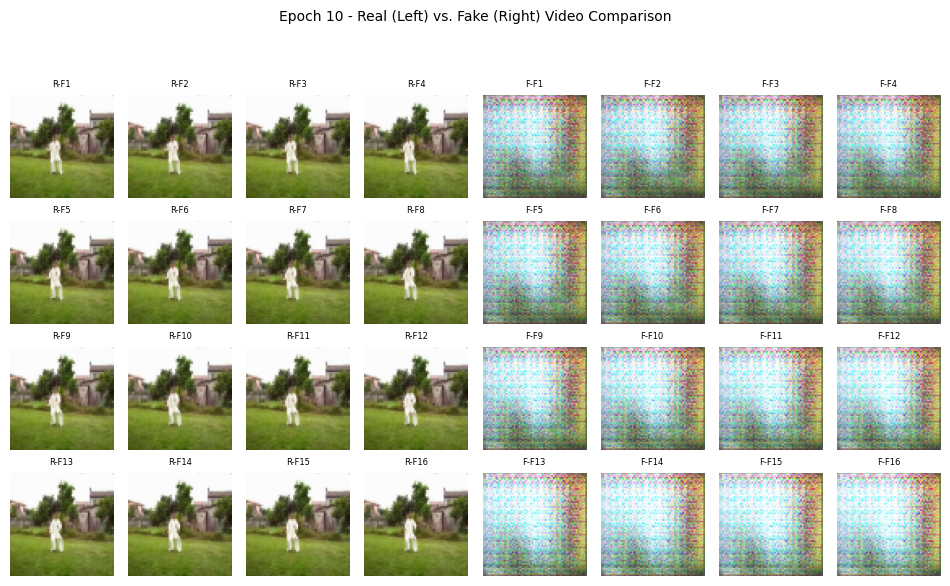

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 124MB/s] 
100%|██████████| 4/4 [00:00<00:00,  8.62it/s]


Epoch 10: Avg SSIM = 0.0744, FID = 411.7139
Epoch 20 - D_loss: 0.8413, G_loss: 2.5880
Epoch 30 - D_loss: 1.5840, G_loss: 4.8922
Epoch 40 - D_loss: 1.1562, G_loss: 3.5236
Epoch 50 - D_loss: 1.4252, G_loss: 4.7053
Epoch 60 - D_loss: 0.8976, G_loss: 3.2373
Epoch 70 - D_loss: 0.6565, G_loss: 2.8867
Epoch 80 - D_loss: 0.8239, G_loss: 2.6967
Epoch 90 - D_loss: 1.0014, G_loss: 6.8762
Epoch 100 - D_loss: 1.5015, G_loss: 9.1291


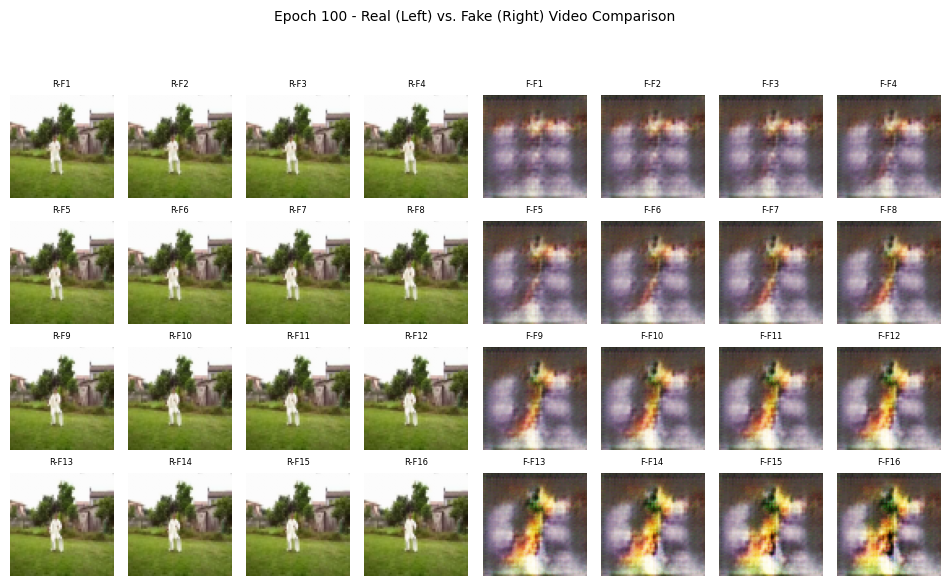

100%|██████████| 4/4 [00:00<00:00,  8.36it/s]


Epoch 100: Avg SSIM = 0.0690, FID = 407.4495
Epoch 110 - D_loss: 0.3802, G_loss: 5.3525
Epoch 120 - D_loss: 0.6998, G_loss: 4.9312
Epoch 130 - D_loss: 0.8420, G_loss: 5.0362
Epoch 140 - D_loss: 0.5180, G_loss: 3.3497
Epoch 150 - D_loss: 0.6402, G_loss: 3.7871
Epoch 160 - D_loss: 0.2049, G_loss: 4.2027
Epoch 170 - D_loss: 2.8598, G_loss: 10.6162
Epoch 180 - D_loss: 0.7050, G_loss: 2.3472
Epoch 190 - D_loss: 0.3108, G_loss: 5.9026
Epoch 200 - D_loss: 0.4331, G_loss: 6.9152


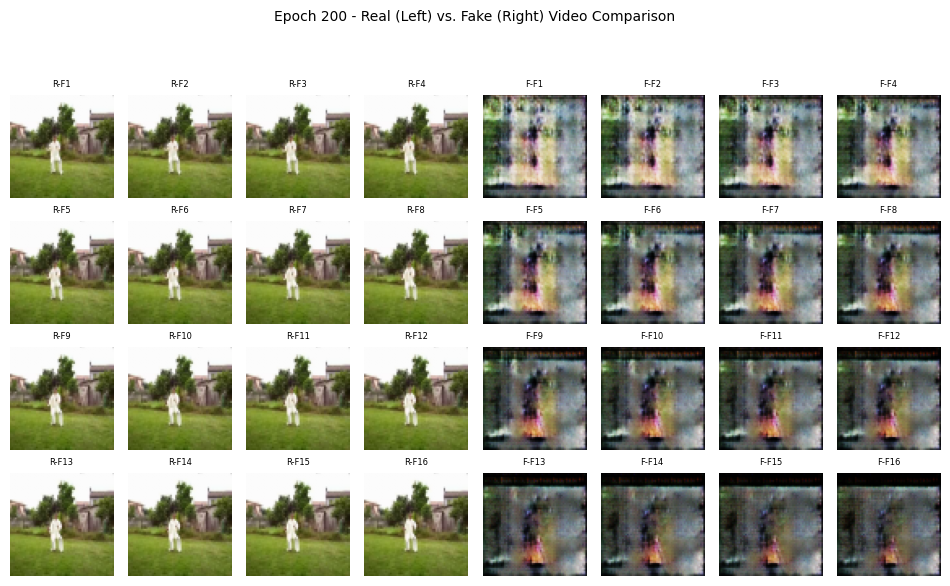

100%|██████████| 4/4 [00:00<00:00,  8.24it/s]


Epoch 200: Avg SSIM = 0.0829, FID = 392.2444
Epoch 210 - D_loss: 3.7279, G_loss: 20.1250
Epoch 220 - D_loss: 0.6086, G_loss: 5.1465
Epoch 230 - D_loss: 0.7906, G_loss: 4.6315
Epoch 240 - D_loss: 0.2322, G_loss: 3.9276
Epoch 250 - D_loss: 0.2289, G_loss: 6.0417
Epoch 260 - D_loss: 0.3237, G_loss: 8.5081
Epoch 270 - D_loss: 0.5237, G_loss: 13.1825
Epoch 280 - D_loss: 0.4254, G_loss: 5.2363
Epoch 290 - D_loss: 2.3210, G_loss: 23.6527
Epoch 300 - D_loss: 1.0999, G_loss: 10.1988


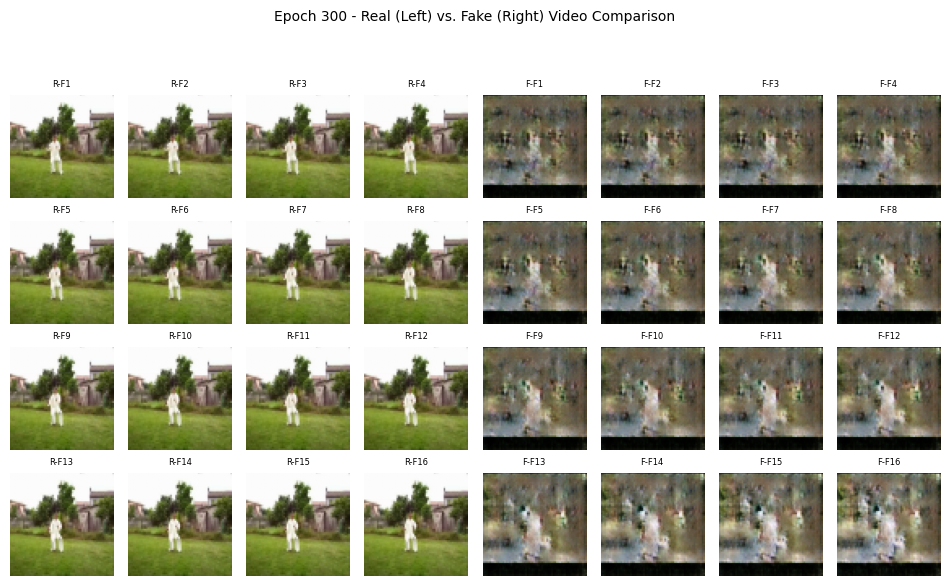

100%|██████████| 4/4 [00:00<00:00,  8.15it/s]


Epoch 300: Avg SSIM = 0.0922, FID = 419.7494
Epoch 310 - D_loss: 0.4505, G_loss: 6.3807
Epoch 320 - D_loss: 0.1284, G_loss: 7.0561
Epoch 330 - D_loss: 0.4251, G_loss: 9.6737
Epoch 340 - D_loss: 0.4971, G_loss: 18.1717
Epoch 350 - D_loss: 0.6890, G_loss: 20.7169
Epoch 360 - D_loss: 1.2714, G_loss: 22.2354
Epoch 370 - D_loss: 0.4193, G_loss: 13.4563
Epoch 380 - D_loss: 0.7117, G_loss: 13.7402
Epoch 390 - D_loss: 0.7576, G_loss: 5.3753
Epoch 400 - D_loss: 1.5937, G_loss: 17.2476


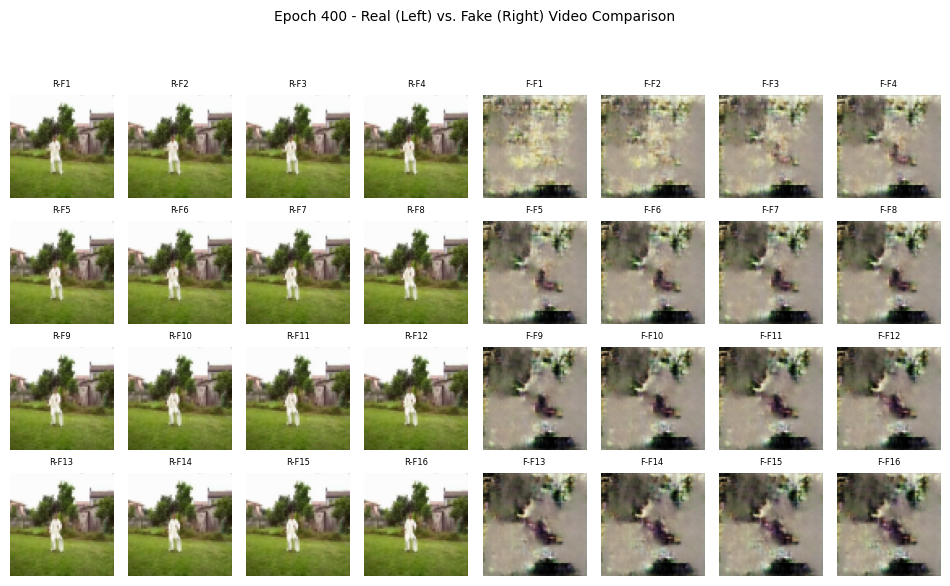

100%|██████████| 4/4 [00:00<00:00,  8.13it/s]


Epoch 400: Avg SSIM = 0.1050, FID = 522.8821
Epoch 410 - D_loss: 0.8457, G_loss: 14.2046
Epoch 420 - D_loss: 2.2698, G_loss: 29.7221
Epoch 430 - D_loss: 4.6039, G_loss: 24.3356
Epoch 440 - D_loss: 2.0778, G_loss: 14.9474
Epoch 450 - D_loss: 3.2383, G_loss: 16.0303
Epoch 460 - D_loss: 1.3438, G_loss: 25.5822
Epoch 470 - D_loss: 0.9049, G_loss: 14.1137
Epoch 480 - D_loss: 0.7290, G_loss: 25.4659
Epoch 490 - D_loss: 2.0880, G_loss: 29.7591
Epoch 500 - D_loss: 0.1400, G_loss: 11.4803


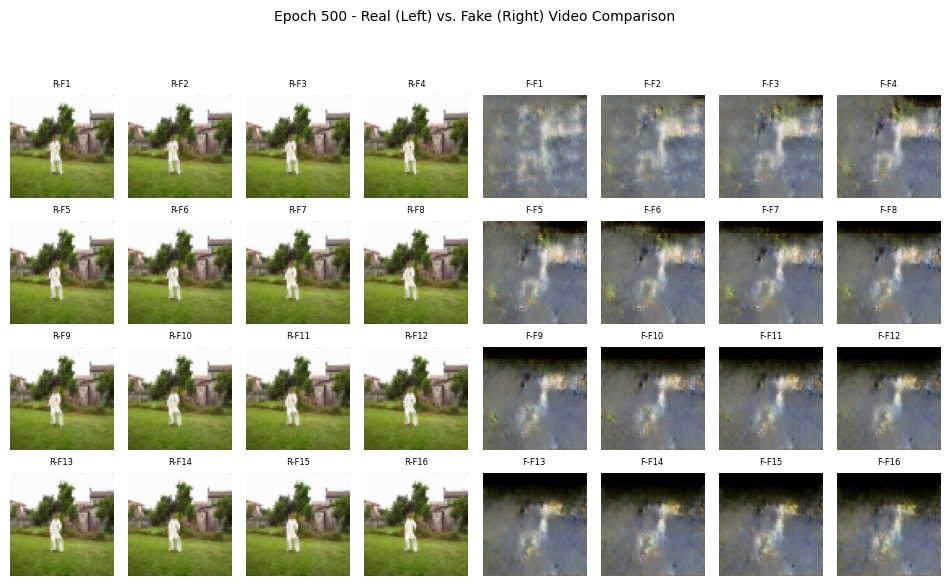

100%|██████████| 4/4 [00:00<00:00,  8.21it/s]


Epoch 500: Avg SSIM = 0.1324, FID = 473.9938
Epoch 510 - D_loss: 1.6441, G_loss: 26.3671
Epoch 520 - D_loss: 0.3534, G_loss: 10.4266
Epoch 530 - D_loss: 0.3142, G_loss: 13.9322
Epoch 540 - D_loss: 0.6524, G_loss: 6.4750
Epoch 570 - D_loss: 0.0663, G_loss: 8.5970
Epoch 580 - D_loss: 0.5541, G_loss: 11.5927
Epoch 590 - D_loss: 0.3789, G_loss: 13.1253
Epoch 600 - D_loss: 0.0012, G_loss: 7.3313


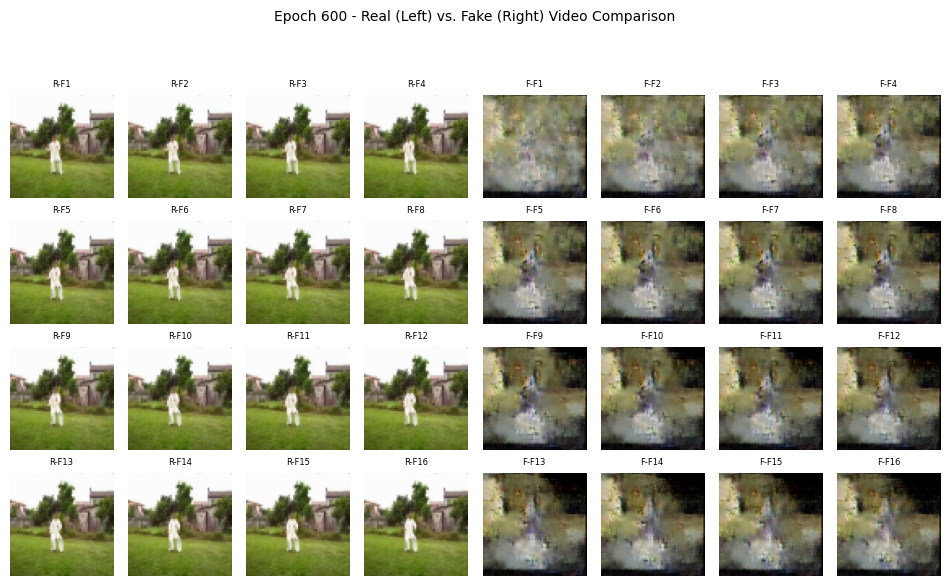

100%|██████████| 4/4 [00:00<00:00,  8.21it/s]


Epoch 600: Avg SSIM = 0.1004, FID = 464.1149
Epoch 610 - D_loss: 0.2323, G_loss: 27.1344
Epoch 620 - D_loss: 0.3508, G_loss: 7.6097
Epoch 630 - D_loss: 0.2999, G_loss: 12.9501
Epoch 640 - D_loss: 1.0061, G_loss: 13.9481
Epoch 650 - D_loss: 0.3122, G_loss: 9.9538
Epoch 660 - D_loss: 0.1907, G_loss: 4.7951
Epoch 670 - D_loss: 0.0883, G_loss: 15.5982
Epoch 680 - D_loss: 0.0114, G_loss: 4.8082
Epoch 690 - D_loss: 0.0026, G_loss: 11.3759
Epoch 700 - D_loss: 0.1833, G_loss: 10.6813


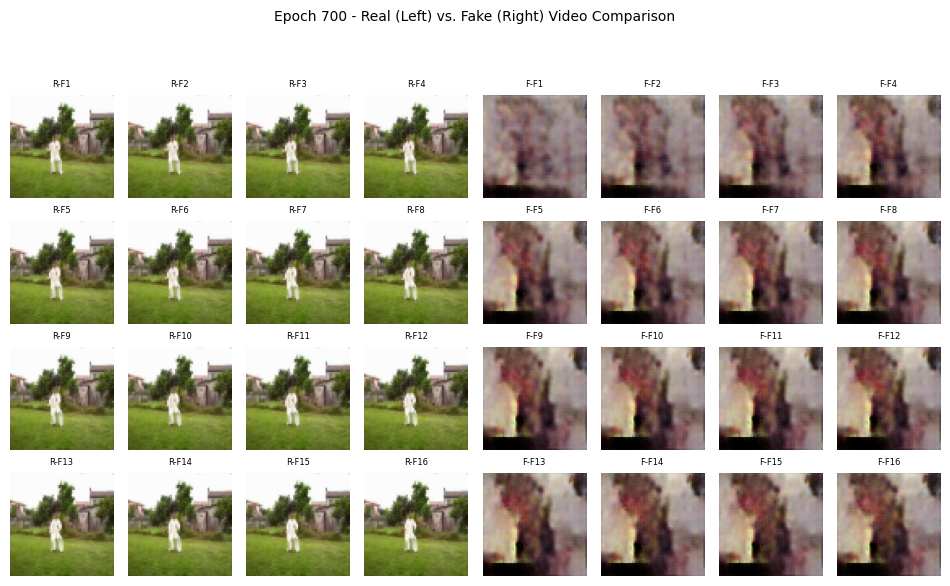

100%|██████████| 4/4 [00:00<00:00,  8.24it/s]


Epoch 700: Avg SSIM = 0.0959, FID = 530.5386
Epoch 710 - D_loss: 0.4773, G_loss: 16.2661
Epoch 720 - D_loss: 0.1210, G_loss: 4.1202
Epoch 730 - D_loss: 0.0143, G_loss: 5.9959
Epoch 740 - D_loss: 0.0380, G_loss: 14.4766
Epoch 750 - D_loss: 2.8239, G_loss: 16.6376
Epoch 760 - D_loss: 0.1075, G_loss: 6.9341
Epoch 770 - D_loss: 1.2115, G_loss: 25.8612
Epoch 780 - D_loss: 1.1757, G_loss: 24.8483
Epoch 790 - D_loss: 0.0301, G_loss: 4.8997
Epoch 800 - D_loss: 0.3648, G_loss: 5.8701


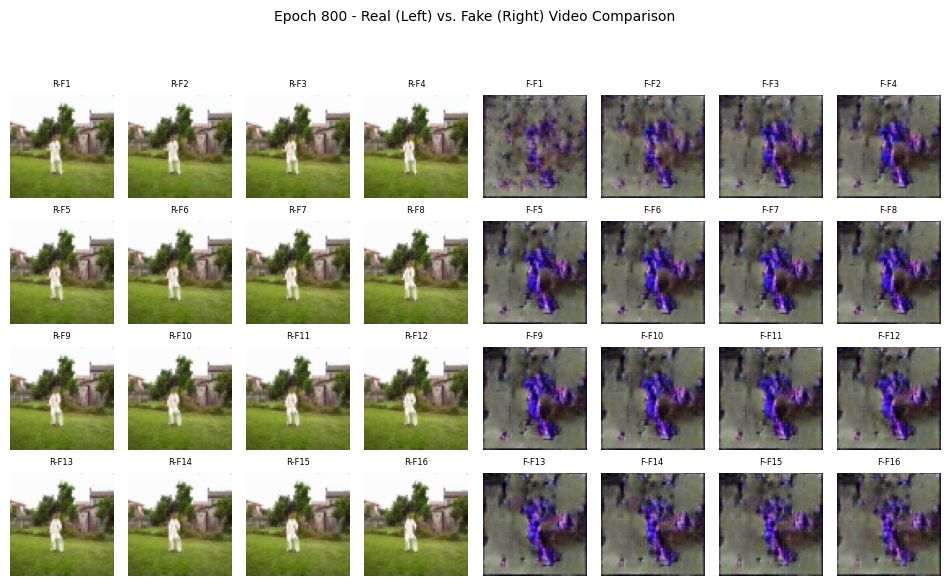

100%|██████████| 4/4 [00:00<00:00,  8.16it/s]


Epoch 800: Avg SSIM = 0.0971, FID = 485.2018
Epoch 810 - D_loss: 0.4278, G_loss: 6.1202
Epoch 820 - D_loss: 13.2116, G_loss: 29.4602
Epoch 830 - D_loss: 0.4782, G_loss: 9.3953
Epoch 840 - D_loss: 0.3900, G_loss: 12.8270
Epoch 850 - D_loss: 0.0057, G_loss: 6.4324
Epoch 860 - D_loss: 3.3268, G_loss: 16.8514
Epoch 870 - D_loss: 0.5536, G_loss: 23.5555
Epoch 880 - D_loss: 0.2810, G_loss: 21.1223
Epoch 890 - D_loss: 0.0483, G_loss: 7.5502
Epoch 900 - D_loss: 0.0687, G_loss: 12.2887


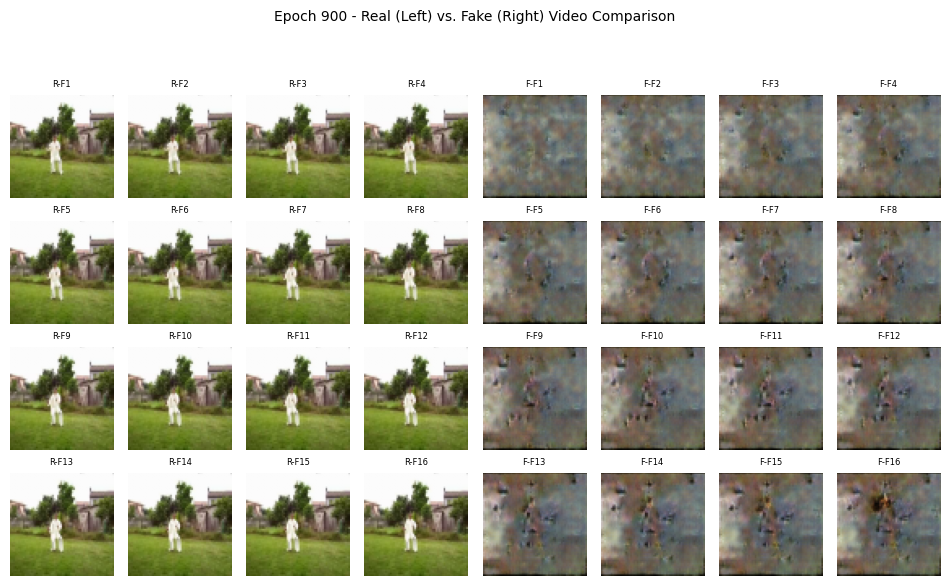

100%|██████████| 4/4 [00:00<00:00,  8.19it/s]


Epoch 900: Avg SSIM = 0.1256, FID = 510.4224
Epoch 910 - D_loss: 0.0081, G_loss: 6.4923
Epoch 920 - D_loss: 0.0097, G_loss: 5.6291
Epoch 930 - D_loss: 0.0002, G_loss: 15.1679
Epoch 940 - D_loss: 0.6493, G_loss: 22.6818
Epoch 950 - D_loss: 3.2232, G_loss: 30.4604
Epoch 960 - D_loss: 0.0120, G_loss: 9.8148
Epoch 970 - D_loss: 2.9529, G_loss: 45.8627
Epoch 980 - D_loss: 0.0066, G_loss: 5.3553
Epoch 990 - D_loss: 0.0652, G_loss: 8.2604
Epoch 1000 - D_loss: 0.0046, G_loss: 14.5451


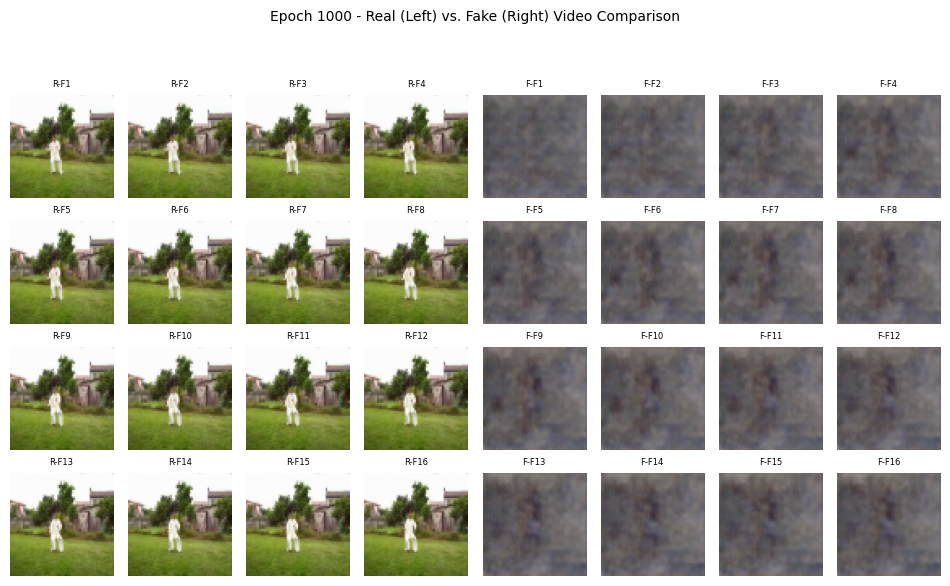

100%|██████████| 4/4 [00:00<00:00,  8.15it/s]


Epoch 1000: Avg SSIM = 0.1735, FID = 670.0814

--- Final Evaluation Results ---
Epoch 10: SSIM = 0.0744, FID = 411.7139
Epoch 100: SSIM = 0.0690, FID = 407.4495
Epoch 200: SSIM = 0.0829, FID = 392.2444
Epoch 300: SSIM = 0.0922, FID = 419.7494
Epoch 400: SSIM = 0.1050, FID = 522.8821
Epoch 500: SSIM = 0.1324, FID = 473.9938
Epoch 600: SSIM = 0.1004, FID = 464.1149
Epoch 700: SSIM = 0.0959, FID = 530.5386
Epoch 800: SSIM = 0.0971, FID = 485.2018
Epoch 900: SSIM = 0.1256, FID = 510.4224
Epoch 1000: SSIM = 0.1735, FID = 670.0814


In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchdiffeq import odeint
from torch.utils.data import DataLoader, Subset, Dataset
import torchvision.models as models
from skimage.metrics import structural_similarity as ssim
import numpy as np
from pytorch_fid import fid_score
import os
import glob
import logging
from PIL import Image # For saving images in FID calculation
import matplotlib.pyplot as plt # Import matplotlib for plotting

# Setup logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Dataset class for loading UCF101 video clips
class UCF101Dataset(Dataset):
    def __init__(self, processed_dir, max_clips=160):
        # Glob for all .pt files within subdirectories of processed_dir
        self.video_paths = glob.glob(f'{processed_dir}/*/*.pt')[:max_clips]
        if not self.video_paths:
            raise ValueError(f"No .pt files found in {processed_dir}. Please ensure data is preprocessed.")
        logger.info(f"Found {len(self.video_paths)} videos for the dataset.")

    def __len__(self):
        return len(self.video_paths)

    def __getitem__(self, idx):
        # Each video clip is expected to be a PyTorch tensor
        # with shape (frames, channels, height, width), e.g., (16, 3, 64, 64)
        return torch.load(self.video_paths[idx])


# Neural ODE function to learn continuous dynamics
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super().__init__()
        # A simple MLP to define the derivative dz/dt = net(z)
        self.net = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim)
        )
    def forward(self, t, z):
        # t is time, z is the latent state
        return self.net(z)

# Custom Residual Block for the Generator's decoder
class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        # First convolutional layer
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        # Second convolutional layer
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)

        # Shortcut connection: 1x1 conv if input/output channels differ, otherwise identity
        self.shortcut = nn.Sequential()
        if in_channels != out_channels:
            self.shortcut = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1)

    def forward(self, x):
        identity = x # Store input for shortcut connection
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)

        out += self.shortcut(identity) # Add shortcut to main path
        out = self.relu(out)
        return out

# Hybrid Generator combining Neural ODE for dynamics and ResNet-based decoder
class Generator(nn.Module):
    def __init__(self, z_dim, hidden_dim, video_shape):
        super().__init__()
        self.z_dim = z_dim
        # Unpack video_shape for clarity (frames, channels, height, width)
        self.video_frames = video_shape[0]
        self.video_channels = video_shape[1]
        self.video_height = video_shape[2]
        self.video_width = video_shape[3]

        self.ode_func = ODEFunc(hidden_dim) # The Neural ODE module

        # Initial mapping from latent vector z to the ODE's initial hidden state
        self.initial_ode_state = nn.Linear(z_dim, hidden_dim)

        # --- ResNet-based Decoder ---
        # This part generates a single frame from a latent state (output of ODE)

        # Calculate the initial spatial resolution for the decoder's first conv layer
        # If target is 64x64 and we have 4 upsampling layers (stride 2 each),
        # initial_res = 64 / (2^4) = 64 / 16 = 4
        initial_decoder_res = self.video_height // (2**4)
        # Number of channels for the initial spatial feature map
        initial_decoder_channels = 512

        # Linear layer to expand the ODE's latent state (hidden_dim) into a
        # 3D spatial feature map (channels, height, width)
        self.fc_to_spatial = nn.Sequential(
            nn.Linear(hidden_dim, initial_decoder_channels * initial_decoder_res * initial_decoder_res),
            nn.ReLU()
        )
        self.initial_spatial_res = initial_decoder_res
        self.initial_spatial_channels = initial_decoder_channels

        # Upsampling blocks using ConvTranspose2d (deconvolution) and ResBlocks
        # Each ConvTranspose2d doubles the spatial dimensions
        self.upsample_block1 = nn.Sequential(
            nn.ConvTranspose2d(self.initial_spatial_channels, 256, kernel_size=4, stride=2, padding=1), # 4x4 -> 8x8
            nn.BatchNorm2d(256),
            nn.ReLU(),
            ResBlock(256, 256) # Apply a ResBlock for feature refinement
        )
        self.upsample_block2 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1), # 8x8 -> 16x16
            nn.BatchNorm2d(128),
            nn.ReLU(),
            ResBlock(128, 128)
        )
        self.upsample_block3 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1), # 16x16 -> 32x32
            nn.BatchNorm2d(64),
            nn.ReLU(),
            ResBlock(64, 64)
        )
        self.upsample_block4 = nn.Sequential(
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1), # 32x32 -> 64x64
            nn.BatchNorm2d(32),
            nn.ReLU(),
            ResBlock(32, 32)
        )
        # Final convolutional layer to map features to image channels (e.g., 3 for RGB)
        self.final_conv = nn.Sequential(
            nn.Conv2d(32, self.video_channels, kernel_size=3, stride=1, padding=1),
            nn.Tanh() # Tanh activation scales output to [-1, 1], suitable for image data
        )

    def forward(self, z):
        batch_size = z.size(0)

        # 1. Initialize the Neural ODE's latent state (z0) from the input noise vector z
        z0 = self.initial_ode_state(z)

        # 2. Evolve the latent state using the Neural ODE
        # 't' defines the time points at which the ODE solution is sampled (corresponding to video frames)
        t = torch.linspace(0, 1, self.video_frames).to(z.device)
        # odeint returns the solution at each 't' for each item in the batch
        # Output shape: (num_time_points, batch_size, hidden_dim)
        zt = odeint(self.ode_func, z0, t, method='rk4') # 'rk4' is a common integration method

        # 3. Decode each evolved latent state into a video frame
        decoded_frames = []
        # Loop through each time point (frame) in the ODE solution
        for i in range(self.video_frames):
            frame_latent_state = zt[i] # Get the latent state for the current frame: (batch_size, hidden_dim)

            # Expand the latent state into a spatial feature map for the decoder
            spatial_features = self.fc_to_spatial(frame_latent_state).view(
                batch_size, self.initial_spatial_channels, self.initial_spatial_res, self.initial_spatial_res
            )

            # Pass the spatial features through the ResNet-based upsampling blocks
            img = self.upsample_block1(spatial_features)
            img = self.upsample_block2(img)
            img = self.upsample_block3(img)
            img = self.upsample_block4(img)
            img = self.final_conv(img) # Final convolution to get the image (channels, H, W)

            decoded_frames.append(img)

        # Stack the individual frames along a new dimension to form a video batch
        # Initial stacked shape: (batch_size, frames, channels, height, width)
        video = torch.stack(decoded_frames, dim=1)

        # Permute the dimensions to match the Discriminator's expected input format:
        # (batch_size, channels, frames, height, width)
        video = video.permute(0, 2, 1, 3, 4)

        return video

# Discriminator (3D Convolutional Neural Network)
class Discriminator(nn.Module):
    def __init__(self, video_shape, hidden_dim):
        super().__init__()
        # video_shape is (frames, channels, height, width) from initial definition
        # Extract dimensions needed for Conv3d calculations
        channels = video_shape[1] # Number of channels (e.g., 3 for RGB)
        frames = video_shape[0]   # Number of frames (depth dimension for Conv3d)
        height = video_shape[2]   # Height of frames
        width = video_shape[3]    # Width of frames

        self.net = nn.Sequential(
            # First 3D convolutional layer
            # Input shape: (batch, channels, frames, height, width) e.g., (N, 3, 16, 64, 64)
            nn.Conv3d(channels, hidden_dim, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2), # Leaky ReLU activation to prevent dead neurons

            # Second 3D convolutional layer
            # Output of first conv: (batch, hidden_dim, 8, 32, 32)
            nn.Conv3d(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            # Output of second conv: (batch, hidden_dim*2, 4, 16, 16)

            nn.Flatten(), # Flatten the output for the linear classification layer

            # Final linear layer to output a single scalar (real/fake prediction)
            # Calculate the input size for the linear layer:
            # hidden_dim * 2 (channels) * 4 (depth) * 16 (height) * 16 (width)
            nn.Linear(hidden_dim * 2 * (frames // 4) * (height // 4) * (width // 4), 1)
        )
    def forward(self, x):
        return self.net(x)

# Function to compute Structural Similarity Index (SSIM) between two video clips
def compute_clip_ssim(real_clip, fake_clip):
    # Inputs: single clip tensors with shape (C, D, H, W) e.g., (3, 16, 64, 64)
    real_clip = real_clip.cpu().numpy()
    fake_clip = fake_clip.cpu().numpy()

    ssim_scores = []
    # Iterate through each frame of the video clip
    for i in range(real_clip.shape[1]): # Accessing the 'depth' or 'frames' dimension
        # Extract a single frame and permute to (H, W, C) for skimage.metrics.ssim
        real_frame = real_clip[:, i, :, :].transpose(1, 2, 0) # From (C, H, W) to (H, W, C)
        fake_frame = fake_clip[:, i, :, :].transpose(1, 2, 0)

        # Normalize pixel values from [-1, 1] to [0, 1] as SSIM expects positive values
        real_frame = (real_frame + 1) / 2
        fake_frame = (fake_frame + 1) / 2

        # Ensure data types are float for ssim calculation
        real_frame = real_frame.astype(np.float32)
        fake_frame = fake_frame.astype(np.float32)

        # Calculate SSIM for the current frame
        # `channel_axis=-1` specifies that the channel dimension is the last one (H, W, C)
        # `data_range=1.0` indicates the maximum possible difference between pixel values (max 1.0 - min 0.0)
        score = ssim(real_frame, fake_frame, channel_axis=-1, data_range=1.0)
        ssim_scores.append(score)
    return np.mean(ssim_scores) # Return the average SSIM score across all frames


# --- Visualization Function (UPDATED for 2x8 grid layout with smaller size) ---
def visualize_video_comparison(real_clip, fake_clip, epoch, save_dir="video_comparisons", display_plot=True):
    """
    Visualizes 16 frames of a single real and fake video clip side-by-side
    within a 4-row, 8-column grid. Saves the plot and optionally displays it.
    The image size is decreased for easier snipping.

    Args:
        real_clip (torch.Tensor): A single real video clip (C, D, H, W).
        fake_clip (torch.Tensor): A single fake video clip (C, D, H, W).
        epoch (int): The current epoch number.
        save_dir (str): Directory to save the comparison images.
        display_plot (bool): If True, calls plt.show() to display the plot interactively.
                              Otherwise, only saves to file.
    """
    # Ensure inputs are on CPU and converted to NumPy for matplotlib
    real_clip_np = real_clip.cpu().numpy()
    fake_clip_np = fake_clip.cpu().numpy()

    num_frames = real_clip_np.shape[1] # Number of frames (D dimension), which is 16
    frames_per_sub_row = 4 # How many frames for R/F in one row of the subplot (e.g., F1-F4)
    
    # Calculate total rows and columns for the main subplot grid
    total_rows = num_frames // frames_per_sub_row # 16 frames / 4 frames per sub-row = 4 rows
    total_cols = frames_per_sub_row * 2 # 4 real frames + 4 fake frames = 8 columns

    # Decrease figsize values for a smaller overall image
    # The default multiplier for an image of 64x64 often is around 1.5-2 per image.
    # We have 8 columns and 4 rows. Let's try smaller multipliers.
    # Experiment with these values: (columns * multiplier_width, rows * multiplier_height)
    fig, axes = plt.subplots(total_rows, total_cols, figsize=(total_cols * 1.2, total_rows * 1.5))

    # Add a main title for the figure
    # Adjust 'y' coordinate to make sure the title doesn't overlap with the top row of images.
    plt.suptitle(f"Epoch {epoch} - Real (Left) vs. Fake (Right) Video Comparison", fontsize=10, y=1.01)

    for i in range(num_frames):
        # Calculate row and column indices for the current frame
        row_idx = i // frames_per_sub_row # 0 for F1-F4, 1 for F5-F8, 2 for F9-F12, 3 for F13-F16
        col_idx_in_block = i % frames_per_sub_row # 0-3 for columns within the 4-frame block

        # Real video frame plotting (left side)
        real_frame = real_clip_np[:, i, :, :].transpose(1, 2, 0)
        real_frame = (real_frame + 1) / 2 # Normalize to [0, 1]
        real_frame = np.clip(real_frame, 0, 1) # Clamp to ensure valid range

        axes[row_idx, col_idx_in_block].imshow(real_frame)
        axes[row_idx, col_idx_in_block].set_title(f"R-F{i+1}", fontsize=6) # Smaller title font
        axes[row_idx, col_idx_in_block].axis('off')

        # Fake video frame plotting (right side - offset columns by frames_per_sub_row)
        fake_frame = fake_clip_np[:, i, :, :].transpose(1, 2, 0)
        fake_frame = (fake_frame + 1) / 2 # Normalize to [0, 1]
        fake_frame = np.clip(fake_frame, 0, 1) # Clamp to ensure valid range

        axes[row_idx, col_idx_in_block + frames_per_sub_row].imshow(fake_frame)
        axes[row_idx, col_idx_in_block + frames_per_sub_row].set_title(f"F-F{i+1}", fontsize=6) # Smaller title font
        axes[row_idx, col_idx_in_block + frames_per_sub_row].axis('off')

    # Adjust layout to prevent elements from overlapping.
    # `rect` adjusts the space for subplots [left, bottom, right, top]
    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    # Create directory for saving visualizations if it doesn't exist
    os.makedirs(save_dir, exist_ok=True)
    save_path = os.path.join(save_dir, f"video_comparison_epoch_{epoch:03d}.png")
    # Save with a slightly lower DPI to contribute to smaller file size, but keep it reasonable
    plt.savefig(save_path, dpi=150)

    if display_plot:
        plt.show() # Display the plot window directly in the output

    # Close the figure to free up memory regardless of whether it was displayed or just saved
    plt.close(fig)


# --- Main Setup and Training Loop ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
processed_dir = '/kaggle/working/ucf101processed' # Directory where preprocessed .pt video clips are stored

# --- Dummy Data Creation (for testing if actual data is not available) ---
# This block creates dummy video files if the processed_dir doesn't exist.
# Each dummy video is a tensor of shape (16, 3, 64, 64) with pixel values in [-1, 1].
if not os.path.exists(processed_dir):
    logger.warning(f"Processed directory {processed_dir} not found. Creating dummy data for demonstration.")
    os.makedirs(processed_dir, exist_ok=True)
    dummy_video_class_path = os.path.join(processed_dir, 'dummy_class')
    os.makedirs(dummy_video_class_path, exist_ok=True)
    for i in range(160): # Create 160 dummy video clips
        dummy_clip = torch.rand(16, 3, 64, 64) * 2 - 1 # Random values in [-1, 1]
        torch.save(dummy_clip, os.path.join(dummy_video_class_path, f'dummy_video_{i:03d}.pt'))
    logger.info(f"Dummy data (160 clips) created in {dummy_video_class_path}.")
# --- End Dummy Data Creation ---

# Initialize dataset and data loaders
dataset = UCF101Dataset(processed_dir)
if len(dataset) == 0:
    raise ValueError("Dataset is empty after initialization. No video clips found to train on.")

# DataLoader for training set
train_loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=2, pin_memory=True)

# Create a test set subset for evaluation
test_indices = torch.randperm(len(dataset))[:min(160, len(dataset))] # Take up to 160 random clips
test_dataset = Subset(dataset, test_indices)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Model parameters
z_dim = 100        # Dimension of the latent noise vector
hidden_dim = 256   # Dimension of the hidden state in ODE and other layers
video_shape = (16, 3, 64, 64) # Expected video shape: (frames, channels, height, width)

# Initialize Generator and Discriminator models and move them to the selected device (CPU/GPU)
generator = Generator(z_dim, hidden_dim, video_shape).to(device)
discriminator = Discriminator(video_shape, hidden_dim).to(device)

# Define Optimizers for Generator and Discriminator
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Loss function (Binary Cross-Entropy with Logits for GANs)
criterion = nn.BCEWithLogitsLoss()

# Epochs at which to perform evaluation (SSIM and FID)
epochs_to_evaluate = [10, 100, 200, 300,400,500,600,700,800,900,1000]
ssim_results = [] # To store SSIM scores at evaluation epochs
fid_results = []  # To store FID scores at evaluation epochs

# Labels for real and fake samples (for BCEWithLogitsLoss)
real_label = 1.0
fake_label = 0.0

print(f"Starting training on device: {device}")
print(f"Generator parameters: {sum(p.numel() for p in generator.parameters() if p.requires_grad):,}")
print(f"Discriminator parameters: {sum(p.numel() for p in discriminator.parameters() if p.requires_grad):,}")


# --- Training Loop ---
for epoch in range(1, 1001):
    generator.train()      # Set generator to training mode
    discriminator.train()  # Set discriminator to training mode

    for i, real_videos_batch in enumerate(train_loader):
        batch_size = real_videos_batch.size(0)

        # 1. Prepare Real Videos for Discriminator
        # Dataset returns (frames, channels, H, W). DataLoader batches to (N, frames, channels, H, W).
        # Discriminator (Conv3d) expects (N, channels, frames, H, W).
        real_videos = real_videos_batch.permute(0, 2, 1, 3, 4).to(device)

        # --- Train Discriminator ---
        d_optimizer.zero_grad()

        # a. Train with real videos
        real_output = discriminator(real_videos)
        real_loss = criterion(real_output, torch.full_like(real_output, real_label))

        # b. Generate fake videos
        z = torch.randn(batch_size, z_dim).to(device) # Sample random noise
        fake_videos = generator(z) # Generator creates fake videos (N, C, D, H, W)

        # c. Train with fake videos (detach to prevent gradients flowing to generator)
        fake_output = discriminator(fake_videos.detach())
        fake_loss = criterion(fake_output, torch.full_like(fake_output, fake_label))

        # Combine real and fake losses for discriminator
        d_loss = real_loss + fake_loss
        d_loss.backward() # Backpropagate discriminator loss
        d_optimizer.step() # Update discriminator weights

        # --- Train Generator ---
        g_optimizer.zero_grad()

        # Generate fake videos again (this time, gradients will flow to generator)
        # Note: fake_videos from previous step might be stale if d_optimizer step changed D.
        # It's safer to regenerate or ensure consistency. Here, we're using the same `fake_videos`
        # as generated in the current D step, which is fine for adversarial training if `detach` is used.
        # But if you want to ensure the Generator's prediction reflects D's *updated* state, regenerate.
        # For simplicity here, we reuse `fake_videos` but it's important to understand the nuance.
        fake_output = discriminator(fake_videos)
        # Generator tries to make fake videos look real, so it aims for real_label
        g_loss = criterion(fake_output, torch.full_like(fake_output, real_label))
        g_loss.backward() # Backpropagate generator loss
        g_optimizer.step() # Update generator weights

        # Print shapes to verify during training (first batch only)
        if i == 0 and epoch == 1: # Only print for the very first batch of the first epoch
            print(f"\n--- Shape Check (Epoch {epoch}, Batch {i}) ---")
            print(f"Real videos batch shape (from DataLoader): {real_videos_batch.shape}")
            print(f"Real videos shape (after permute, input to Discriminator): {real_videos.shape}")
            print(f"Fake videos shape (output of Generator, input to Discriminator): {fake_videos.shape}")
            print("--- End Shape Check ---\n")

    # Print loss statistics periodically
    if epoch % 10 == 0 or epoch in epochs_to_evaluate:
        print(f"Epoch {epoch} - D_loss: {d_loss.item():.4f}, G_loss: {g_loss.item():.4f}")

    # --- Evaluation Block (SSIM, FID, and Visualization) ---
    if epoch in epochs_to_evaluate:
        generator.eval() # Set generator to evaluation mode (disables dropout, BatchNorm updates)
        ssim_scores = []
        real_videos_list = [] # List to accumulate real video batches for FID
        fake_videos_list = [] # List to accumulate fake video batches for FID

        # This flag ensures we only visualize one example per evaluation epoch
        visualized_this_epoch = False

        with torch.no_grad(): # Disable gradient calculation for evaluation
            for j, real_videos_batch_test in enumerate(test_loader):
                # Prepare real videos for evaluation (same permutation as training)
                real_videos_test = real_videos_batch_test.permute(0, 2, 1, 3, 4).to(device)
                batch_size_test = real_videos_test.size(0)

                # Generate fake videos for evaluation
                z_test = torch.randn(batch_size_test, z_dim).to(device)
                fake_videos_test = generator(z_test)

                # --- Visualization ---
                if not visualized_this_epoch: # Only visualize once per evaluation epoch
                    # Select the first video clip from the current batch for visualization
                    # Ensure batch_size_test is at least 1
                    if batch_size_test > 0:
                        # Call visualize_video_comparison with display_plot=True to show it directly
                        visualize_video_comparison(real_videos_test[0], fake_videos_test[0], epoch, display_plot=True)
                        visualized_this_epoch = True # Set flag to true after visualizing

                # Compute SSIM for each clip in the batch
                for k in range(batch_size_test):
                    ssim_score = compute_clip_ssim(real_videos_test[k], fake_videos_test[k])
                    ssim_scores.append(ssim_score)

                # Accumulate videos for FID calculation (move to CPU to save memory if on GPU)
                real_videos_list.append(real_videos_test.cpu())
                fake_videos_list.append(fake_videos_test.cpu())

        # Calculate average SSIM for the epoch
        avg_ssim = np.mean(ssim_scores)
        ssim_results.append(avg_ssim)

        # --- FID Calculation ---
        # Clean up existing directories before saving new images to avoid mixing data
        if os.path.exists('real'):
            for f in glob.glob('real/*.png'): os.remove(f)
            os.rmdir('real')
        if os.path.exists('fake'):
            for f in glob.glob('fake/*.png'): os.remove(f)
            os.rmdir('fake')

        os.makedirs('real', exist_ok=True)
        os.makedirs('fake', exist_ok=True)

        # Concatenate all accumulated video batches
        all_real_videos = torch.cat(real_videos_list) # Shape: (Total_N, C, D, H, W)
        all_fake_videos = torch.cat(fake_videos_list) # Shape: (Total_N, C, D, H, W)

        # For FID, we typically compare image features, so we extract and save frames.
        # Here, we save the first frame of each video clip.
        for idx in range(all_real_videos.shape[0]):
            # Get the first frame: (C, H, W)
            real_frame = all_real_videos[idx, :, 0, :, :]
            fake_frame = all_fake_videos[idx, :, 0, :, :]

            # Convert tensor from [-1, 1] to [0, 1], then to [0, 255] and uint8 for PIL
            # Clamp values to [0, 1] before scaling to 255 to prevent issues from tanh or numerical errors
            real_frame = torch.clamp((real_frame + 1) / 2, 0, 1)
            fake_frame = torch.clamp((fake_frame + 1) / 2, 0, 1)

            real_frame_np = (real_frame * 255).byte().permute(1, 2, 0).numpy()
            fake_frame_np = (fake_frame * 255).byte().permute(1, 2, 0).numpy()

            Image.fromarray(real_frame_np).save(f'real/{idx:04d}.png')
            Image.fromarray(fake_frame_np).save(f'fake/{idx:04d}.png')

        try:
            # Ensure there are images to calculate FID from
            if len(glob.glob('real/*.png')) > 0 and len(glob.glob('fake/*.png')) > 0:
                # Calculate FID score between real and fake image directories
                # batch_size for FID calculation should be <= number of images
                fid = fid_score.calculate_fid_given_paths(
                    ['real', 'fake'],
                    batch_size=min(50, all_real_videos.shape[0]), # Adjust batch size for FID if total images are less than 50
                    device=device,
                    dims=2048 # Using 2048-dimensional features from InceptionV3
                )
                fid_results.append(fid)
            else:
                logger.warning(f"Epoch {epoch}: Not enough images saved for FID calculation. Skipping FID.")
                fid_results.append(np.nan) # Append NaN if FID cannot be calculated
        except Exception as e:
            logger.error(f"Epoch {epoch}: Error calculating FID: {e}. Skipping FID for this epoch.")
            fid_results.append(np.nan) # Append NaN if FID calculation fails

        # Print evaluation results for the current epoch
        print(f"Epoch {epoch}: Avg SSIM = {avg_ssim:.4f}, FID = {fid_results[-1]:.4f}")

# --- Final Results Summary ---
print("\n--- Final Evaluation Results ---")
for e, ssim_val, fid_val in zip(epochs_to_evaluate, ssim_results, fid_results):
    print(f"Epoch {e}: SSIM = {ssim_val:.4f}, FID = {fid_val:.4f}")

## INCREASING THE EPOCHS TO 2000

Starting training on device: cuda
Generator parameters: 6,619,971
Discriminator parameters: 8,962,817

--- Shape Check (Epoch 1, Batch 0) ---
Real videos batch shape (from DataLoader): torch.Size([16, 16, 3, 64, 64])
Real videos shape (after permute, input to Discriminator): torch.Size([16, 3, 16, 64, 64])
Fake videos shape (output of Generator, input to Discriminator): torch.Size([16, 3, 16, 64, 64])
--- End Shape Check ---

Epoch 10 - D_loss: 3.6638, G_loss: 2.1603


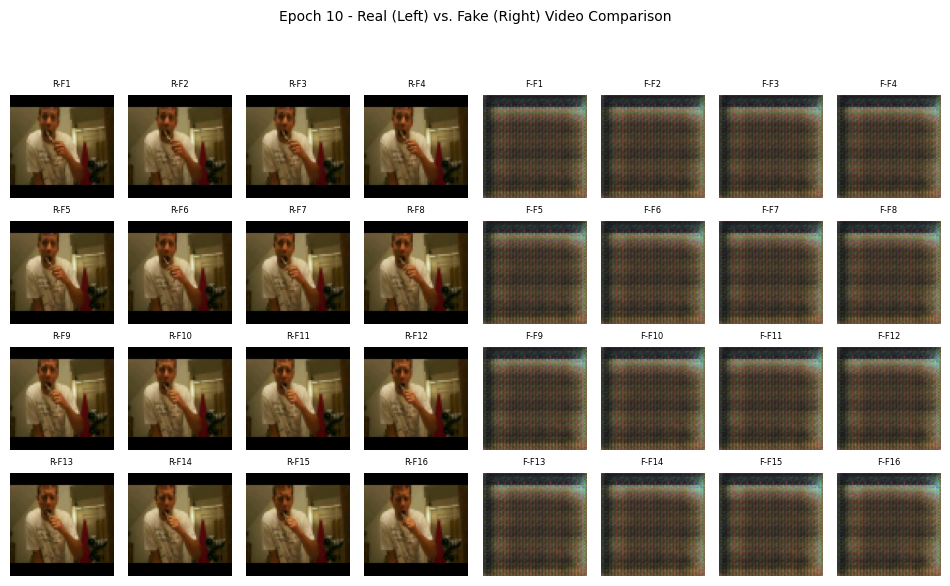

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:01<00:00, 79.9MB/s]
100%|██████████| 4/4 [00:00<00:00,  8.69it/s]


Epoch 10: Avg SSIM = 0.0780, FID = 364.9534
Epoch 20 - D_loss: 0.9457, G_loss: 3.6819
Epoch 30 - D_loss: 0.8722, G_loss: 3.1288
Epoch 40 - D_loss: 1.1614, G_loss: 4.2004
Epoch 50 - D_loss: 0.6301, G_loss: 2.9758
Epoch 60 - D_loss: 0.8746, G_loss: 4.2386
Epoch 70 - D_loss: 1.9273, G_loss: 2.5116
Epoch 80 - D_loss: 0.8550, G_loss: 7.2637
Epoch 90 - D_loss: 1.3321, G_loss: 8.9526
Epoch 100 - D_loss: 0.4206, G_loss: 2.8015
Epoch 110 - D_loss: 0.7901, G_loss: 2.7551
Epoch 120 - D_loss: 0.7514, G_loss: 3.9920
Epoch 130 - D_loss: 0.6910, G_loss: 5.2437
Epoch 140 - D_loss: 0.3744, G_loss: 6.6305
Epoch 150 - D_loss: 0.5998, G_loss: 6.3781
Epoch 160 - D_loss: 0.0819, G_loss: 6.7767
Epoch 170 - D_loss: 0.8510, G_loss: 3.4906
Epoch 180 - D_loss: 0.6240, G_loss: 6.9700
Epoch 190 - D_loss: 0.2904, G_loss: 6.5063
Epoch 200 - D_loss: 0.2653, G_loss: 6.6691
Epoch 210 - D_loss: 0.6470, G_loss: 5.5096
Epoch 220 - D_loss: 0.4951, G_loss: 6.9558
Epoch 230 - D_loss: 0.2916, G_loss: 6.6032
Epoch 240 - D_loss

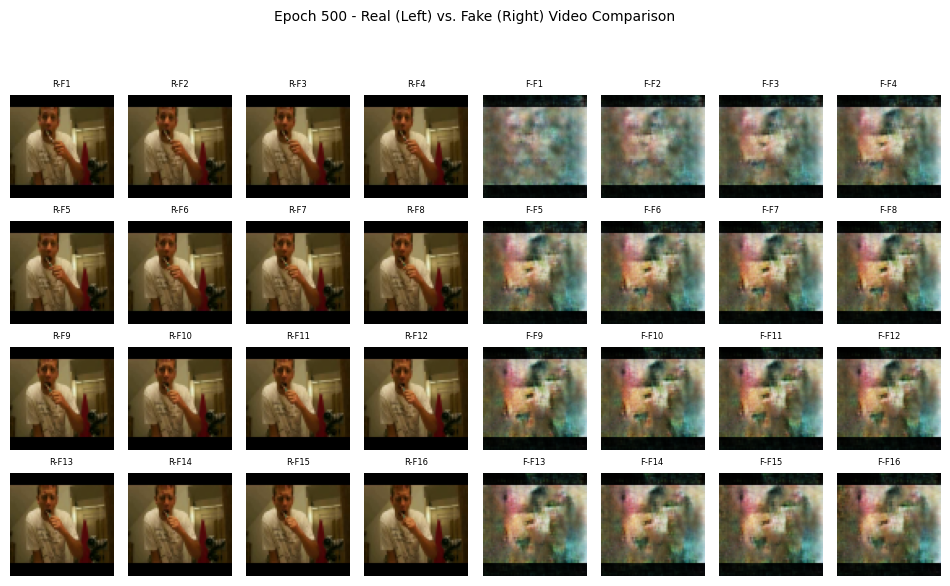

100%|██████████| 4/4 [00:00<00:00,  8.49it/s]


Epoch 500: Avg SSIM = 0.1229, FID = 466.2261
Epoch 510 - D_loss: 0.6321, G_loss: 31.3770
Epoch 520 - D_loss: 0.5526, G_loss: 25.9641
Epoch 530 - D_loss: 0.0679, G_loss: 4.3916
Epoch 540 - D_loss: 3.0956, G_loss: 47.4379
Epoch 550 - D_loss: 2.8081, G_loss: 26.2556
Epoch 560 - D_loss: 0.7171, G_loss: 19.0097
Epoch 570 - D_loss: 4.3977, G_loss: 29.5143
Epoch 580 - D_loss: 2.2200, G_loss: 36.6939
Epoch 590 - D_loss: 0.2634, G_loss: 22.2925
Epoch 600 - D_loss: 1.1114, G_loss: 16.9919
Epoch 610 - D_loss: 0.1887, G_loss: 2.7897
Epoch 620 - D_loss: 1.0779, G_loss: 13.8161
Epoch 630 - D_loss: 0.5470, G_loss: 5.0924
Epoch 640 - D_loss: 0.0020, G_loss: 6.9891
Epoch 650 - D_loss: 2.6234, G_loss: 38.4761
Epoch 660 - D_loss: 0.5873, G_loss: 13.3613
Epoch 670 - D_loss: 0.0000, G_loss: 12.7565
Epoch 680 - D_loss: 0.4095, G_loss: 6.8960
Epoch 690 - D_loss: 0.2731, G_loss: 13.9054
Epoch 700 - D_loss: 4.0149, G_loss: 28.9933
Epoch 710 - D_loss: 0.0331, G_loss: 5.8018
Epoch 720 - D_loss: 0.2812, G_loss: 1

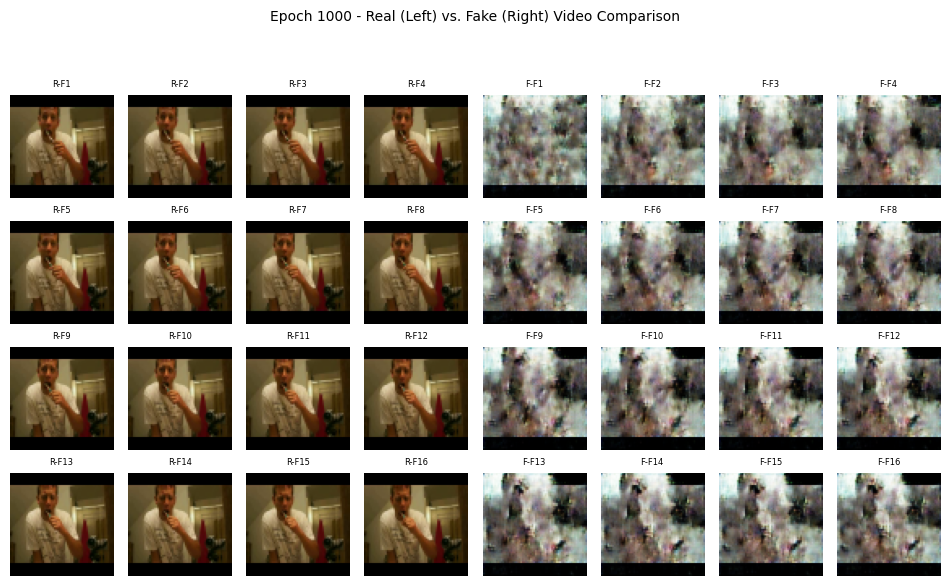

100%|██████████| 4/4 [00:00<00:00,  8.52it/s]


Epoch 1000: Avg SSIM = 0.0820, FID = 575.9775
Epoch 1010 - D_loss: 0.0017, G_loss: 4.8945
Epoch 1020 - D_loss: 0.0670, G_loss: 40.6267
Epoch 1030 - D_loss: 5.2880, G_loss: 40.1236
Epoch 1040 - D_loss: 0.0002, G_loss: 16.6912
Epoch 1050 - D_loss: 0.3066, G_loss: 6.1953
Epoch 1060 - D_loss: 0.0064, G_loss: 5.6478
Epoch 1070 - D_loss: 0.0158, G_loss: 28.5918
Epoch 1080 - D_loss: 0.0074, G_loss: 5.5897
Epoch 1090 - D_loss: 0.0049, G_loss: 27.3822
Epoch 1100 - D_loss: 0.4741, G_loss: 36.8556
Epoch 1110 - D_loss: 0.2265, G_loss: 30.6745
Epoch 1120 - D_loss: 0.0809, G_loss: 11.3405
Epoch 1130 - D_loss: 0.2883, G_loss: 48.8725
Epoch 1140 - D_loss: 0.0010, G_loss: 62.2123
Epoch 1150 - D_loss: 2.5612, G_loss: 35.5614
Epoch 1160 - D_loss: 0.0003, G_loss: 15.9873
Epoch 1170 - D_loss: 2.8498, G_loss: 43.2557
Epoch 1180 - D_loss: 0.0402, G_loss: 10.7910
Epoch 1190 - D_loss: 0.0060, G_loss: 10.4426
Epoch 1200 - D_loss: 0.0001, G_loss: 26.7772
Epoch 1210 - D_loss: 0.0000, G_loss: 18.5117
Epoch 1220 - 

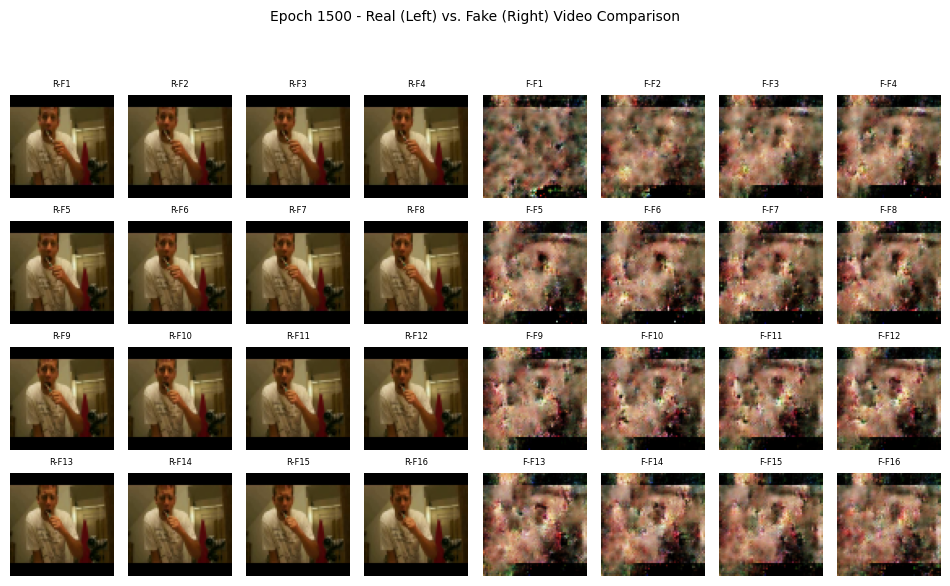

100%|██████████| 4/4 [00:00<00:00,  8.21it/s]


Epoch 1500: Avg SSIM = 0.0882, FID = 513.1720
Epoch 1510 - D_loss: 4.0040, G_loss: 129.6689
Epoch 1520 - D_loss: 0.0003, G_loss: 29.2232
Epoch 1530 - D_loss: 0.0000, G_loss: 12.4283
Epoch 1540 - D_loss: 8.9148, G_loss: 79.3158
Epoch 1550 - D_loss: 0.0000, G_loss: 14.9469
Epoch 1560 - D_loss: 0.8085, G_loss: 0.8422
Epoch 1570 - D_loss: 0.0905, G_loss: 8.8080
Epoch 1580 - D_loss: 0.9461, G_loss: 51.9193
Epoch 1590 - D_loss: 0.0001, G_loss: 17.2608
Epoch 1600 - D_loss: 0.0000, G_loss: 19.4704
Epoch 1610 - D_loss: 0.0406, G_loss: 9.1783
Epoch 1620 - D_loss: 0.0233, G_loss: 9.5479
Epoch 1630 - D_loss: 0.0000, G_loss: 31.7927
Epoch 1640 - D_loss: 0.0002, G_loss: 12.2269
Epoch 1650 - D_loss: 2.5163, G_loss: 73.7667
Epoch 1660 - D_loss: 0.0021, G_loss: 6.7370
Epoch 1670 - D_loss: 0.0095, G_loss: 6.0349
Epoch 1680 - D_loss: 0.0001, G_loss: 16.7737
Epoch 1690 - D_loss: 0.0000, G_loss: 23.3457
Epoch 1700 - D_loss: 0.0004, G_loss: 7.8457
Epoch 1710 - D_loss: 0.0000, G_loss: 43.7943
Epoch 1720 - D_

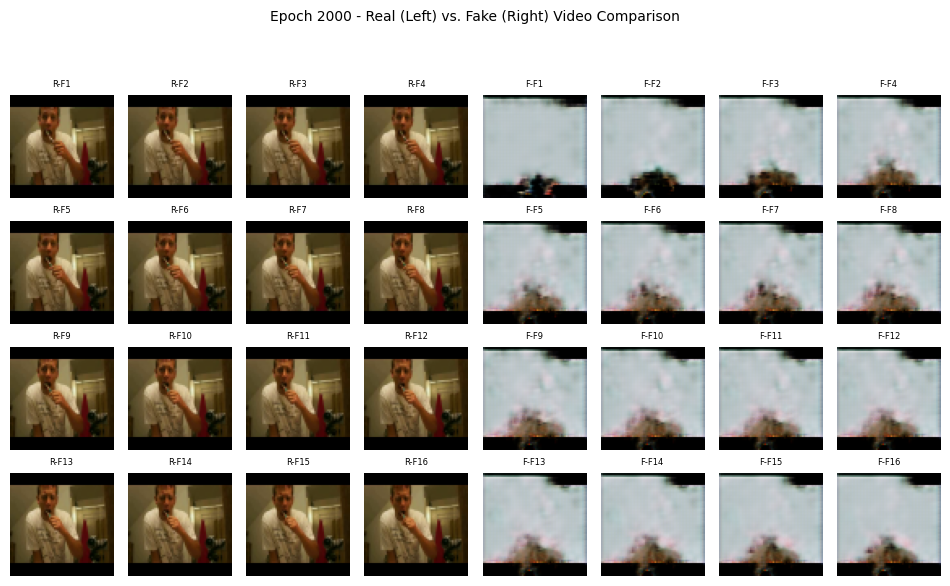

100%|██████████| 4/4 [00:00<00:00,  8.43it/s]


Epoch 2000: Avg SSIM = 0.1521, FID = 439.1692

--- Final Evaluation Results ---
Epoch 10: SSIM = 0.0780, FID = 364.9534
Epoch 500: SSIM = 0.1229, FID = 466.2261
Epoch 1000: SSIM = 0.0820, FID = 575.9775
Epoch 1500: SSIM = 0.0882, FID = 513.1720
Epoch 2000: SSIM = 0.1521, FID = 439.1692


In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchdiffeq import odeint
from torch.utils.data import DataLoader, Subset, Dataset
import torchvision.models as models
from skimage.metrics import structural_similarity as ssim
import numpy as np
from pytorch_fid import fid_score
import os
import glob
import logging
from PIL import Image # For saving images in FID calculation
import matplotlib.pyplot as plt # Import matplotlib for plotting

# Setup logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Dataset class for loading UCF101 video clips
class UCF101Dataset(Dataset):
    def __init__(self, processed_dir, max_clips=160):
        # Glob for all .pt files within subdirectories of processed_dir
        self.video_paths = glob.glob(f'{processed_dir}/*/*.pt')[:max_clips]
        if not self.video_paths:
            raise ValueError(f"No .pt files found in {processed_dir}. Please ensure data is preprocessed.")
        logger.info(f"Found {len(self.video_paths)} videos for the dataset.")

    def __len__(self):
        return len(self.video_paths)

    def __getitem__(self, idx):
        # Each video clip is expected to be a PyTorch tensor
        # with shape (frames, channels, height, width), e.g., (16, 3, 64, 64)
        return torch.load(self.video_paths[idx])


# Neural ODE function to learn continuous dynamics
class ODEFunc(nn.Module):
    def __init__(self, hidden_dim):
        super().__init__()
        # A simple MLP to define the derivative dz/dt = net(z)
        self.net = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim)
        )
    def forward(self, t, z):
        # t is time, z is the latent state
        return self.net(z)

# Custom Residual Block for the Generator's decoder
class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        # First convolutional layer
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        # Second convolutional layer
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)

        # Shortcut connection: 1x1 conv if input/output channels differ, otherwise identity
        self.shortcut = nn.Sequential()
        if in_channels != out_channels:
            self.shortcut = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1)

    def forward(self, x):
        identity = x # Store input for shortcut connection
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)

        out += self.shortcut(identity) # Add shortcut to main path
        out = self.relu(out)
        return out

# Hybrid Generator combining Neural ODE for dynamics and ResNet-based decoder
class Generator(nn.Module):
    def __init__(self, z_dim, hidden_dim, video_shape):
        super().__init__()
        self.z_dim = z_dim
        # Unpack video_shape for clarity (frames, channels, height, width)
        self.video_frames = video_shape[0]
        self.video_channels = video_shape[1]
        self.video_height = video_shape[2]
        self.video_width = video_shape[3]

        self.ode_func = ODEFunc(hidden_dim) # The Neural ODE module

        # Initial mapping from latent vector z to the ODE's initial hidden state
        self.initial_ode_state = nn.Linear(z_dim, hidden_dim)

        # --- ResNet-based Decoder ---
        # This part generates a single frame from a latent state (output of ODE)

        # Calculate the initial spatial resolution for the decoder's first conv layer
        # If target is 64x64 and we have 4 upsampling layers (stride 2 each),
        # initial_res = 64 / (2^4) = 64 / 16 = 4
        initial_decoder_res = self.video_height // (2**4)
        # Number of channels for the initial spatial feature map
        initial_decoder_channels = 512

        # Linear layer to expand the ODE's latent state (hidden_dim) into a
        # 3D spatial feature map (channels, height, width)
        self.fc_to_spatial = nn.Sequential(
            nn.Linear(hidden_dim, initial_decoder_channels * initial_decoder_res * initial_decoder_res),
            nn.ReLU()
        )
        self.initial_spatial_res = initial_decoder_res
        self.initial_spatial_channels = initial_decoder_channels

        # Upsampling blocks using ConvTranspose2d (deconvolution) and ResBlocks
        # Each ConvTranspose2d doubles the spatial dimensions
        self.upsample_block1 = nn.Sequential(
            nn.ConvTranspose2d(self.initial_spatial_channels, 256, kernel_size=4, stride=2, padding=1), # 4x4 -> 8x8
            nn.BatchNorm2d(256),
            nn.ReLU(),
            ResBlock(256, 256) # Apply a ResBlock for feature refinement
        )
        self.upsample_block2 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1), # 8x8 -> 16x16
            nn.BatchNorm2d(128),
            nn.ReLU(),
            ResBlock(128, 128)
        )
        self.upsample_block3 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1), # 16x16 -> 32x32
            nn.BatchNorm2d(64),
            nn.ReLU(),
            ResBlock(64, 64)
        )
        self.upsample_block4 = nn.Sequential(
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1), # 32x32 -> 64x64
            nn.BatchNorm2d(32),
            nn.ReLU(),
            ResBlock(32, 32)
        )
        # Final convolutional layer to map features to image channels (e.g., 3 for RGB)
        self.final_conv = nn.Sequential(
            nn.Conv2d(32, self.video_channels, kernel_size=3, stride=1, padding=1),
            nn.Tanh() # Tanh activation scales output to [-1, 1], suitable for image data
        )

    def forward(self, z):
        batch_size = z.size(0)

        # 1. Initialize the Neural ODE's latent state (z0) from the input noise vector z
        z0 = self.initial_ode_state(z)

        # 2. Evolve the latent state using the Neural ODE
        # 't' defines the time points at which the ODE solution is sampled (corresponding to video frames)
        t = torch.linspace(0, 1, self.video_frames).to(z.device)
        # odeint returns the solution at each 't' for each item in the batch
        # Output shape: (num_time_points, batch_size, hidden_dim)
        zt = odeint(self.ode_func, z0, t, method='rk4') # 'rk4' is a common integration method

        # 3. Decode each evolved latent state into a video frame
        decoded_frames = []
        # Loop through each time point (frame) in the ODE solution
        for i in range(self.video_frames):
            frame_latent_state = zt[i] # Get the latent state for the current frame: (batch_size, hidden_dim)

            # Expand the latent state into a spatial feature map for the decoder
            spatial_features = self.fc_to_spatial(frame_latent_state).view(
                batch_size, self.initial_spatial_channels, self.initial_spatial_res, self.initial_spatial_res
            )

            # Pass the spatial features through the ResNet-based upsampling blocks
            img = self.upsample_block1(spatial_features)
            img = self.upsample_block2(img)
            img = self.upsample_block3(img)
            img = self.upsample_block4(img)
            img = self.final_conv(img) # Final convolution to get the image (channels, H, W)

            decoded_frames.append(img)

        # Stack the individual frames along a new dimension to form a video batch
        # Initial stacked shape: (batch_size, frames, channels, height, width)
        video = torch.stack(decoded_frames, dim=1)

        # Permute the dimensions to match the Discriminator's expected input format:
        # (batch_size, channels, frames, height, width)
        video = video.permute(0, 2, 1, 3, 4)

        return video

# Discriminator (3D Convolutional Neural Network)
class Discriminator(nn.Module):
    def __init__(self, video_shape, hidden_dim):
        super().__init__()
        # video_shape is (frames, channels, height, width) from initial definition
        # Extract dimensions needed for Conv3d calculations
        channels = video_shape[1] # Number of channels (e.g., 3 for RGB)
        frames = video_shape[0]   # Number of frames (depth dimension for Conv3d)
        height = video_shape[2]   # Height of frames
        width = video_shape[3]    # Width of frames

        self.net = nn.Sequential(
            # First 3D convolutional layer
            # Input shape: (batch, channels, frames, height, width) e.g., (N, 3, 16, 64, 64)
            nn.Conv3d(channels, hidden_dim, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2), # Leaky ReLU activation to prevent dead neurons

            # Second 3D convolutional layer
            # Output of first conv: (batch, hidden_dim, 8, 32, 32)
            nn.Conv3d(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            # Output of second conv: (batch, hidden_dim*2, 4, 16, 16)

            nn.Flatten(), # Flatten the output for the linear classification layer

            # Final linear layer to output a single scalar (real/fake prediction)
            # Calculate the input size for the linear layer:
            # hidden_dim * 2 (channels) * 4 (depth) * 16 (height) * 16 (width)
            nn.Linear(hidden_dim * 2 * (frames // 4) * (height // 4) * (width // 4), 1)
        )
    def forward(self, x):
        return self.net(x)

# Function to compute Structural Similarity Index (SSIM) between two video clips
def compute_clip_ssim(real_clip, fake_clip):
    # Inputs: single clip tensors with shape (C, D, H, W) e.g., (3, 16, 64, 64)
    real_clip = real_clip.cpu().numpy()
    fake_clip = fake_clip.cpu().numpy()

    ssim_scores = []
    # Iterate through each frame of the video clip
    for i in range(real_clip.shape[1]): # Accessing the 'depth' or 'frames' dimension
        # Extract a single frame and permute to (H, W, C) for skimage.metrics.ssim
        real_frame = real_clip[:, i, :, :].transpose(1, 2, 0) # From (C, H, W) to (H, W, C)
        fake_frame = fake_clip[:, i, :, :].transpose(1, 2, 0)

        # Normalize pixel values from [-1, 1] to [0, 1] as SSIM expects positive values
        real_frame = (real_frame + 1) / 2
        fake_frame = (fake_frame + 1) / 2

        # Ensure data types are float for ssim calculation
        real_frame = real_frame.astype(np.float32)
        fake_frame = fake_frame.astype(np.float32)

        # Calculate SSIM for the current frame
        # `channel_axis=-1` specifies that the channel dimension is the last one (H, W, C)
        # `data_range=1.0` indicates the maximum possible difference between pixel values (max 1.0 - min 0.0)
        score = ssim(real_frame, fake_frame, channel_axis=-1, data_range=1.0)
        ssim_scores.append(score)
    return np.mean(ssim_scores) # Return the average SSIM score across all frames


# --- Visualization Function (UPDATED for 2x8 grid layout with smaller size) ---
def visualize_video_comparison(real_clip, fake_clip, epoch, save_dir="video_comparisons", display_plot=True):
    """
    Visualizes 16 frames of a single real and fake video clip side-by-side
    within a 4-row, 8-column grid. Saves the plot and optionally displays it.
    The image size is decreased for easier snipping.

    Args:
        real_clip (torch.Tensor): A single real video clip (C, D, H, W).
        fake_clip (torch.Tensor): A single fake video clip (C, D, H, W).
        epoch (int): The current epoch number.
        save_dir (str): Directory to save the comparison images.
        display_plot (bool): If True, calls plt.show() to display the plot interactively.
                              Otherwise, only saves to file.
    """
    # Ensure inputs are on CPU and converted to NumPy for matplotlib
    real_clip_np = real_clip.cpu().numpy()
    fake_clip_np = fake_clip.cpu().numpy()

    num_frames = real_clip_np.shape[1] # Number of frames (D dimension), which is 16
    frames_per_sub_row = 4 # How many frames for R/F in one row of the subplot (e.g., F1-F4)
    
    # Calculate total rows and columns for the main subplot grid
    total_rows = num_frames // frames_per_sub_row # 16 frames / 4 frames per sub-row = 4 rows
    total_cols = frames_per_sub_row * 2 # 4 real frames + 4 fake frames = 8 columns

    # Decrease figsize values for a smaller overall image
    # The default multiplier for an image of 64x64 often is around 1.5-2 per image.
    # We have 8 columns and 4 rows. Let's try smaller multipliers.
    # Experiment with these values: (columns * multiplier_width, rows * multiplier_height)
    fig, axes = plt.subplots(total_rows, total_cols, figsize=(total_cols * 1.2, total_rows * 1.5))

    # Add a main title for the figure
    # Adjust 'y' coordinate to make sure the title doesn't overlap with the top row of images.
    plt.suptitle(f"Epoch {epoch} - Real (Left) vs. Fake (Right) Video Comparison", fontsize=10, y=1.01)

    for i in range(num_frames):
        # Calculate row and column indices for the current frame
        row_idx = i // frames_per_sub_row # 0 for F1-F4, 1 for F5-F8, 2 for F9-F12, 3 for F13-F16
        col_idx_in_block = i % frames_per_sub_row # 0-3 for columns within the 4-frame block

        # Real video frame plotting (left side)
        real_frame = real_clip_np[:, i, :, :].transpose(1, 2, 0)
        real_frame = (real_frame + 1) / 2 # Normalize to [0, 1]
        real_frame = np.clip(real_frame, 0, 1) # Clamp to ensure valid range

        axes[row_idx, col_idx_in_block].imshow(real_frame)
        axes[row_idx, col_idx_in_block].set_title(f"R-F{i+1}", fontsize=6) # Smaller title font
        axes[row_idx, col_idx_in_block].axis('off')

        # Fake video frame plotting (right side - offset columns by frames_per_sub_row)
        fake_frame = fake_clip_np[:, i, :, :].transpose(1, 2, 0)
        fake_frame = (fake_frame + 1) / 2 # Normalize to [0, 1]
        fake_frame = np.clip(fake_frame, 0, 1) # Clamp to ensure valid range

        axes[row_idx, col_idx_in_block + frames_per_sub_row].imshow(fake_frame)
        axes[row_idx, col_idx_in_block + frames_per_sub_row].set_title(f"F-F{i+1}", fontsize=6) # Smaller title font
        axes[row_idx, col_idx_in_block + frames_per_sub_row].axis('off')

    # Adjust layout to prevent elements from overlapping.
    # `rect` adjusts the space for subplots [left, bottom, right, top]
    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    # Create directory for saving visualizations if it doesn't exist
    os.makedirs(save_dir, exist_ok=True)
    save_path = os.path.join(save_dir, f"video_comparison_epoch_{epoch:03d}.png")
    # Save with a slightly lower DPI to contribute to smaller file size, but keep it reasonable
    plt.savefig(save_path, dpi=150)

    if display_plot:
        plt.show() # Display the plot window directly in the output

    # Close the figure to free up memory regardless of whether it was displayed or just saved
    plt.close(fig)


# --- Main Setup and Training Loop ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
processed_dir = '/kaggle/working/ucf101processed' # Directory where preprocessed .pt video clips are stored

# --- Dummy Data Creation (for testing if actual data is not available) ---
# This block creates dummy video files if the processed_dir doesn't exist.
# Each dummy video is a tensor of shape (16, 3, 64, 64) with pixel values in [-1, 1].
if not os.path.exists(processed_dir):
    logger.warning(f"Processed directory {processed_dir} not found. Creating dummy data for demonstration.")
    os.makedirs(processed_dir, exist_ok=True)
    dummy_video_class_path = os.path.join(processed_dir, 'dummy_class')
    os.makedirs(dummy_video_class_path, exist_ok=True)
    for i in range(160): # Create 160 dummy video clips
        dummy_clip = torch.rand(16, 3, 64, 64) * 2 - 1 # Random values in [-1, 1]
        torch.save(dummy_clip, os.path.join(dummy_video_class_path, f'dummy_video_{i:03d}.pt'))
    logger.info(f"Dummy data (160 clips) created in {dummy_video_class_path}.")
# --- End Dummy Data Creation ---

# Initialize dataset and data loaders
dataset = UCF101Dataset(processed_dir)
if len(dataset) == 0:
    raise ValueError("Dataset is empty after initialization. No video clips found to train on.")

# DataLoader for training set
train_loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=2, pin_memory=True)

# Create a test set subset for evaluation
test_indices = torch.randperm(len(dataset))[:min(160, len(dataset))] # Take up to 160 random clips
test_dataset = Subset(dataset, test_indices)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Model parameters
z_dim = 100        # Dimension of the latent noise vector
hidden_dim = 256   # Dimension of the hidden state in ODE and other layers
video_shape = (16, 3, 64, 64) # Expected video shape: (frames, channels, height, width)

# Initialize Generator and Discriminator models and move them to the selected device (CPU/GPU)
generator = Generator(z_dim, hidden_dim, video_shape).to(device)
discriminator = Discriminator(video_shape, hidden_dim).to(device)

# Define Optimizers for Generator and Discriminator
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Loss function (Binary Cross-Entropy with Logits for GANs)
criterion = nn.BCEWithLogitsLoss()

# Epochs at which to perform evaluation (SSIM and FID)
epochs_to_evaluate = [10, 500,1000,1500,2000]
ssim_results = [] # To store SSIM scores at evaluation epochs
fid_results = []  # To store FID scores at evaluation epochs

# Labels for real and fake samples (for BCEWithLogitsLoss)
real_label = 1.0
fake_label = 0.0

print(f"Starting training on device: {device}")
print(f"Generator parameters: {sum(p.numel() for p in generator.parameters() if p.requires_grad):,}")
print(f"Discriminator parameters: {sum(p.numel() for p in discriminator.parameters() if p.requires_grad):,}")


# --- Training Loop ---
for epoch in range(1, 2001):
    generator.train()      # Set generator to training mode
    discriminator.train()  # Set discriminator to training mode

    for i, real_videos_batch in enumerate(train_loader):
        batch_size = real_videos_batch.size(0)

        # 1. Prepare Real Videos for Discriminator
        # Dataset returns (frames, channels, H, W). DataLoader batches to (N, frames, channels, H, W).
        # Discriminator (Conv3d) expects (N, channels, frames, H, W).
        real_videos = real_videos_batch.permute(0, 2, 1, 3, 4).to(device)

        # --- Train Discriminator ---
        d_optimizer.zero_grad()

        # a. Train with real videos
        real_output = discriminator(real_videos)
        real_loss = criterion(real_output, torch.full_like(real_output, real_label))

        # b. Generate fake videos
        z = torch.randn(batch_size, z_dim).to(device) # Sample random noise
        fake_videos = generator(z) # Generator creates fake videos (N, C, D, H, W)

        # c. Train with fake videos (detach to prevent gradients flowing to generator)
        fake_output = discriminator(fake_videos.detach())
        fake_loss = criterion(fake_output, torch.full_like(fake_output, fake_label))

        # Combine real and fake losses for discriminator
        d_loss = real_loss + fake_loss
        d_loss.backward() # Backpropagate discriminator loss
        d_optimizer.step() # Update discriminator weights

        # --- Train Generator ---
        g_optimizer.zero_grad()

        # Generate fake videos again (this time, gradients will flow to generator)
        # Note: fake_videos from previous step might be stale if d_optimizer step changed D.
        # It's safer to regenerate or ensure consistency. Here, we're using the same `fake_videos`
        # as generated in the current D step, which is fine for adversarial training if `detach` is used.
        # But if you want to ensure the Generator's prediction reflects D's *updated* state, regenerate.
        # For simplicity here, we reuse `fake_videos` but it's important to understand the nuance.
        fake_output = discriminator(fake_videos)
        # Generator tries to make fake videos look real, so it aims for real_label
        g_loss = criterion(fake_output, torch.full_like(fake_output, real_label))
        g_loss.backward() # Backpropagate generator loss
        g_optimizer.step() # Update generator weights

        # Print shapes to verify during training (first batch only)
        if i == 0 and epoch == 1: # Only print for the very first batch of the first epoch
            print(f"\n--- Shape Check (Epoch {epoch}, Batch {i}) ---")
            print(f"Real videos batch shape (from DataLoader): {real_videos_batch.shape}")
            print(f"Real videos shape (after permute, input to Discriminator): {real_videos.shape}")
            print(f"Fake videos shape (output of Generator, input to Discriminator): {fake_videos.shape}")
            print("--- End Shape Check ---\n")

    # Print loss statistics periodically
    if epoch % 10 == 0 or epoch in epochs_to_evaluate:
        print(f"Epoch {epoch} - D_loss: {d_loss.item():.4f}, G_loss: {g_loss.item():.4f}")

    # --- Evaluation Block (SSIM, FID, and Visualization) ---
    if epoch in epochs_to_evaluate:
        generator.eval() # Set generator to evaluation mode (disables dropout, BatchNorm updates)
        ssim_scores = []
        real_videos_list = [] # List to accumulate real video batches for FID
        fake_videos_list = [] # List to accumulate fake video batches for FID

        # This flag ensures we only visualize one example per evaluation epoch
        visualized_this_epoch = False

        with torch.no_grad(): # Disable gradient calculation for evaluation
            for j, real_videos_batch_test in enumerate(test_loader):
                # Prepare real videos for evaluation (same permutation as training)
                real_videos_test = real_videos_batch_test.permute(0, 2, 1, 3, 4).to(device)
                batch_size_test = real_videos_test.size(0)

                # Generate fake videos for evaluation
                z_test = torch.randn(batch_size_test, z_dim).to(device)
                fake_videos_test = generator(z_test)

                # --- Visualization ---
                if not visualized_this_epoch: # Only visualize once per evaluation epoch
                    # Select the first video clip from the current batch for visualization
                    # Ensure batch_size_test is at least 1
                    if batch_size_test > 0:
                        # Call visualize_video_comparison with display_plot=True to show it directly
                        visualize_video_comparison(real_videos_test[0], fake_videos_test[0], epoch, display_plot=True)
                        visualized_this_epoch = True # Set flag to true after visualizing

                # Compute SSIM for each clip in the batch
                for k in range(batch_size_test):
                    ssim_score = compute_clip_ssim(real_videos_test[k], fake_videos_test[k])
                    ssim_scores.append(ssim_score)

                # Accumulate videos for FID calculation (move to CPU to save memory if on GPU)
                real_videos_list.append(real_videos_test.cpu())
                fake_videos_list.append(fake_videos_test.cpu())

        # Calculate average SSIM for the epoch
        avg_ssim = np.mean(ssim_scores)
        ssim_results.append(avg_ssim)

        # --- FID Calculation ---
        # Clean up existing directories before saving new images to avoid mixing data
        if os.path.exists('real'):
            for f in glob.glob('real/*.png'): os.remove(f)
            os.rmdir('real')
        if os.path.exists('fake'):
            for f in glob.glob('fake/*.png'): os.remove(f)
            os.rmdir('fake')

        os.makedirs('real', exist_ok=True)
        os.makedirs('fake', exist_ok=True)

        # Concatenate all accumulated video batches
        all_real_videos = torch.cat(real_videos_list) # Shape: (Total_N, C, D, H, W)
        all_fake_videos = torch.cat(fake_videos_list) # Shape: (Total_N, C, D, H, W)

        # For FID, we typically compare image features, so we extract and save frames.
        # Here, we save the first frame of each video clip.
        for idx in range(all_real_videos.shape[0]):
            # Get the first frame: (C, H, W)
            real_frame = all_real_videos[idx, :, 0, :, :]
            fake_frame = all_fake_videos[idx, :, 0, :, :]

            # Convert tensor from [-1, 1] to [0, 1], then to [0, 255] and uint8 for PIL
            # Clamp values to [0, 1] before scaling to 255 to prevent issues from tanh or numerical errors
            real_frame = torch.clamp((real_frame + 1) / 2, 0, 1)
            fake_frame = torch.clamp((fake_frame + 1) / 2, 0, 1)

            real_frame_np = (real_frame * 255).byte().permute(1, 2, 0).numpy()
            fake_frame_np = (fake_frame * 255).byte().permute(1, 2, 0).numpy()

            Image.fromarray(real_frame_np).save(f'real/{idx:04d}.png')
            Image.fromarray(fake_frame_np).save(f'fake/{idx:04d}.png')

        try:
            # Ensure there are images to calculate FID from
            if len(glob.glob('real/*.png')) > 0 and len(glob.glob('fake/*.png')) > 0:
                # Calculate FID score between real and fake image directories
                # batch_size for FID calculation should be <= number of images
                fid = fid_score.calculate_fid_given_paths(
                    ['real', 'fake'],
                    batch_size=min(50, all_real_videos.shape[0]), # Adjust batch size for FID if total images are less than 50
                    device=device,
                    dims=2048 # Using 2048-dimensional features from InceptionV3
                )
                fid_results.append(fid)
            else:
                logger.warning(f"Epoch {epoch}: Not enough images saved for FID calculation. Skipping FID.")
                fid_results.append(np.nan) # Append NaN if FID cannot be calculated
        except Exception as e:
            logger.error(f"Epoch {epoch}: Error calculating FID: {e}. Skipping FID for this epoch.")
            fid_results.append(np.nan) # Append NaN if FID calculation fails

        # Print evaluation results for the current epoch
        print(f"Epoch {epoch}: Avg SSIM = {avg_ssim:.4f}, FID = {fid_results[-1]:.4f}")

# --- Final Results Summary ---
print("\n--- Final Evaluation Results ---")
for e, ssim_val, fid_val in zip(epochs_to_evaluate, ssim_results, fid_results):
    print(f"Epoch {e}: SSIM = {ssim_val:.4f}, FID = {fid_val:.4f}")